<a href="https://colab.research.google.com/github/nalsadi/UKFNeuralNet/blob/master/UKFNNREDO.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# UKF Optimization for a Neural Network

Note: This is a filterpy implementation

### Three Core Components:
1. Install Libs

2. The UKF Library

3. The UKF Implementation 

## Install Requirements 

In [1]:
!pip install filterpy

## Setting Up the Library and Globals

In [2]:
from pprint import pformat
import numpy as np
import matplotlib.pyplot as plt
import collections
import logging
from filterpy.kalman import KalmanFilter, UnscentedKalmanFilter, MerweScaledSigmaPoints, unscented_transform
from keras.models import Sequential
from keras.layers import Dense, Dropout
import math, os, time, logging
from sklearn.metrics import mean_squared_error
from keras.callbacks import Callback

epochs = 12
train_series_length = 500
test_series_length = 1000
mg_tau = 30
window_size = 12    # M
ukf_dt = 0.1
alpha, beta, kappa = 1, 2, 1  # Worked well
# alpha, beta, kappa = 0.001, 2, 1
Q_var = 0.001
R_var = 0.001
train_ukf_ann = True
#X_data = None
#y_data = None
hxw_model = None
curr_idx = 0


Using TensorFlow backend.


##Tools for Plotting and Data Generation 

In [3]:
figures_list = []


def add_figure_to_save(fig):
    figures_list.append(fig)


def save_all_figures(dir):
    for i, fig in enumerate(figures_list):
        filename = dir + '/fig_' + str(i) + '.png'
        fig.savefig(filename)
    print('All figures saved to {}'.format(dir))


def setup_logging(output_dir):
    log_filename = output_dir + '/' + 'run_log.log'

    # noinspection PyArgumentList
    logging.basicConfig(
        format="%(asctime)s [%(levelname)s] %(message)s",
        handlers=[logging.StreamHandler(),
                  logging.FileHandler(log_filename, 'w+')],
        level=logging.INFO
    )


def plot(x, y, xlabel=None, y_label=None, title=None, new_figure=True, **kwargs):
    if new_figure:
        fig = plt.figure()
        add_figure_to_save(fig)
        plt.title(title)
        plt.xlabel(xlabel)
        plt.ylabel(y_label)
    plt.plot(x, y, **kwargs)
    plt.legend(loc='upper right')


def mackey_glass(sample_len=1000, tau=17, seed=None, n_samples=1):
    '''
    mackey_glass(sample_len=1000, tau=17, seed = None, n_samples = 1) -> input
    Generate the Mackey Glass time-series. Parameters are:
        - sample_len: length of the time-series in timesteps. Default is 1000.
        - tau: delay of the MG - system. Commonly used values are tau=17 (mild
          chaos) and tau=30 (moderate chaos). Default is 17.
        - seed: to seed the random generator, can be used to generate the same
          timeseries at each invocation.
        - n_samples : number of samples to generate
    '''
    delta_t = 10
    history_len = tau * delta_t
    # Initial conditions for the history of the system
    timeseries = 1.2

    if seed is not None:
        np.random.seed(seed)

    samples = []

    for _ in range(n_samples):
        history = collections.deque(1.2 * np.ones(history_len) + 0.2 * \
                                    (np.random.rand(history_len) - 0.5))
        # Preallocate the array for the time-series
        inp = np.zeros((sample_len, 1))

        for timestep in range(sample_len):
            for _ in range(delta_t):
                xtau = history.popleft()
                history.append(timeseries)
                timeseries = history[-1] + (0.2 * xtau / (1.0 + xtau ** 10) - 0.1 * history[-1]) / delta_t
            inp[timestep] = timeseries

        # Squash timeseries through tanh
        inp = np.tanh(inp - 1)
        samples.append(inp)
    return samples


def generate_state_series(x_init, F, Q, n_samples):
    """ Generates a series of state variables
        # Arguments
            x_init: Initial value of state variables (Mx1)
            F: Process state transition matrix (MxM)
            Q: Process noise covariance matrix (MxM)
        # Returns
            A numpy array (M x n_samples)
    """
    M = x_init.shape[0]
    x_series = np.zeros(shape=(M, n_samples))
    x_series[:, 0] = x_init[:, 0]

    for i in range(1, n_samples):
        x_series[:, i] = np.matmul(x_series[:, i-1], F)

    return x_series


def generate_measurement_series(x_series, H, R=None, noise_type='gaussian'):
    """ Generates a series of measurements for a series of state variables
            # Arguments
                x_series: Series of state variables (M x n_samples)
                H: Measurement function matrix (DxM)
                R: Measurement noise covariance matrix (DxD)
            # Returns
                A numpy array (D x n_samples)
        """
    n_samples = x_series.shape[1]
    D = H.shape[0]

    z_series = np.matmul(H, x_series)   # D x n_samples

    if R is not None:
        for dim in range(D):
            mean = 0.
            var = R.diagonal()[dim]
            noise = get_noise_series(noise_type, mean, var, n_samples)
            z_series[dim, :] += noise

    return z_series


def get_noise_series(noise_type, mean, var, n_samples):
    if noise_type == 'gaussian':
        noise = np.random.normal(mean, var, n_samples)
    elif noise_type == 'uniform':
        a = (3 * var) ** 0.5  # variance = a^2 / 3 for uniform~(-a, +a)
        noise = np.random.uniform(low=-a, high=a, size=n_samples)
    else:
        assert False

    return noise

def predict_series(ann, X_data, series_length, window):
    pred = ann.predict(X_data)
    y_pred_series = np.zeros(series_length)
    y_pred_series[window + 1:] = pred.reshape(len(pred))

    y_self_pred_series = np.zeros(series_length)
    y_self_pred_series[:window] = X_data[0]
    for i in range(window, series_length):
        X_window = y_self_pred_series[i - window:i]
        y = ann.predict(X_window.reshape(1, window))  # Reshape needed
        y_self_pred_series[i] = y

    return y_pred_series, y_self_pred_series

In [4]:
class EpochInfoTracker(Callback):
    def __init__(self):
        self.weights_history = []

    def on_epoch_end(self, epoch, logs=None):
        weights_vec = get_weights_vector(self.model)
        self.weights_history.append(weights_vec)

In [5]:
try:
  !mkdir output
except:
  print("Already exists")
setup_logging('output')
logging.info('Experiment parameters below')
window = window_size
dt = 0.01
n_samples = train_series_length


mkdir: cannot create directory ‘output’: File exists


2020-07-17 18:07:26,862 [INFO] Experiment parameters below


In [6]:
def prepare_dataset(series, M, stride):
    X, y = [], []
    for i in range(0, len(series) - M - 1, stride):
        window = series[i:(i + M)]  #
        X.append(window)
        y.append(series[i + M])
    return np.array(X), np.array(y)

## Set up UKF 

In [7]:
class Params:
    pass


params = Params()
params.epochs = 12
params.train_series_length = 500
params.test_series_length = 1000
params.mg_tau = 30
params.window_size = 12    # M
params.ukf_dt = 0.1
params.alpha, params.beta, params.kappa = 1, 2, 1  # Worked well
# params.alpha, params.beta, params.kappa = 0.001, 2, 1
params.Q_var = 0.001
params.R_var = 0.001

# To make training data and related variables accessible across functions
params.train_ukf_ann = True
params.X_data = None
params.y_data = None
params.hxw_model = None
params.curr_idx = 0


def measurement_func(w, x):
    hxw_model = params.hxw_model
    set_weights(hxw_model, w)
    hxw = hxw_model.predict(x.reshape(1, len(x)))   # Reshape needed to feed x as 1 sample to ANN model
    hxw = hxw.flatten() # Flatten to make shape = (1,)
    return hxw


def fw(w, dt=None):
    return w    # Identity


def hw(w):
    x = params.X_data[params.curr_idx]
    hxw = measurement_func(w, x)
    return hxw


def create_ukf(Q, R, dt, w_init, P_init):
    M = w_init.shape[0]

    points = MerweScaledSigmaPoints(M, params.alpha, params.beta, params.kappa)

    ukf = UnscentedKalmanFilter(dim_x=M, dim_z=1, dt=dt, fx=fw, hx=hw, points=points)
    ukf.x = w_init
    ukf.P = P_init
    ukf.R = R
    ukf.Q = Q

    return ukf

In [8]:
train_ukf_ann = True
#X_data = None
#y_data = None
globals()['hxw_model'] = None
#hxw_model = None
curr_idx = 0

def measurement_func(w, x):
    hxw_model = globals()['hxw_model'] #hxw_model
    set_weights(hxw_model, w)
    hxw = hxw_model.predict(x.reshape(1, len(x)))   # Reshape needed to feed x as 1 sample to ANN model
    hxw = hxw.flatten() # Flatten to make shape = (1,)
    return hxw

def fw(w, dt=None):
    return w    # Identity

def hw(w):
    X_data = params.X_data
    x = X_data[curr_idx]
    hxw = measurement_func(w, x)
    return hxw

def create_ukf(Q, R, dt, w_init, P_init):
    M = w_init.shape[0]
    points = MerweScaledSigmaPoints(M, alpha, beta, kappa)
    ukf = UnscentedKalmanFilter(dim_x=M, dim_z=1, dt=dt, fx=fw, hx=hw, points=points)
    ukf.x = w_init
    ukf.P = P_init
    ukf.R = R
    ukf.Q = Q
    return ukf

## Neural Net Tools

In [9]:
def create_neural_net(M):
    ann = Sequential()
    ann.add(Dense(1, input_dim=M, activation='tanh'))  # output (x_k) - no activation because we don't want to limit the range of output
    ann.compile(optimizer='sgd', loss='mse')
    ann.summary()
    return ann

In [10]:
def get_weights_vector(model):
    weights = model.get_weights()
    # logging.info(weights)
    weights_vec = []
    for w_mat in weights:
        weights_vec.extend(w_mat.reshape(w_mat.size))

    weights_vec = np.array(weights_vec)
    return weights_vec

def set_weights(model, weights_vec):
    prev_weights = model.get_weights()
    # logging.info(prev_weights)
    new_weights = []
    start = 0

    for prev_w_mat in prev_weights:
        end = start + prev_w_mat.size
        new_w_mat = np.array(weights_vec[start: end]).reshape(prev_w_mat.shape)
        new_weights.append(new_w_mat)
        start = end

    model.set_weights(new_weights)

In [11]:
def evaluate_neural_nets(sgd_ann, ukf_ann, window, use_train_series=False, train_series=None):
    
    if use_train_series:
        X_data, y_data = params.X_data, params.y_data
        
        series = train_series
        sample_len = params.train_series_length
        title = "Train series (true vs. predicted)"
    else:
        sample_len = test_series_length
        series = mackey_glass(sample_len=sample_len, tau=mg_tau)
        series = np.array(series[0]).reshape((sample_len))
        X_data, y_data = prepare_dataset(series, window, stride=1)
        title = "Test series (true vs. predicted)"
    ukf_pred, ukf_self_pred = predict_series(ukf_ann, X_data, sample_len, window)
    plot(range(sample_len), series, title=title, label='True series')
    plot(range(sample_len), ukf_pred, new_figure=False, label='UKF ANN prediction (based on true windows)')

## Data Generation

In [12]:
#X_series = mackey_glass(sample_len=n_samples, tau=mg_tau, n_samples=window)
#X_series = np.array(X_series[0]).reshape((n_samples))

#globals()['X_data'], globals()['y_data'] = prepare_dataset(X_series, window, stride=1)

X_series = mackey_glass(sample_len=n_samples, tau=params.mg_tau, n_samples=window)
X_series = np.array(X_series[0]).reshape((n_samples))

params.X_data, params.y_data = prepare_dataset(X_series, window, stride=1)

## Setting Up Neural Network

In [13]:
# Create ANN, get its initial weights
globals()['hxw_model'] = create_neural_net(window)
w_init = get_weights_vector(hxw_model)
num_weights = w_init.shape[0]
P_init = 0.1 * np.eye(num_weights)  # Initial values of covariance matrix of state variables (MxM)
Q = Q_var * np.eye(num_weights)  # Process noise covariance matrix (MxM)
R = np.array([[R_var]])  # Measurement noise covariance matrix (DxD)

ukf_ann = create_neural_net(window)
ukf_ann.set_weights(hxw_model.get_weights())  # Same starting point as the UKF_ANN

z_true_series = params.y_data
num_iter = params.epochs * len(z_true_series)

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 1)                 13        
Total params: 13
Trainable params: 13
Non-trainable params: 0
_________________________________________________________________
Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2 (Dense)              (None, 1)                 13        
Total params: 13
Trainable params: 13
Non-trainable params: 0
_________________________________________________________________


## Main 

### Instantiaizing UKF

In [14]:
ukf_filter = create_ukf(Q, R, dt, w_init, P_init)
ukf_w = np.zeros((num_weights, epochs))
ukf_train_mse = np.zeros(epochs)

### Training Loop

2020-07-17 17:23:30,474 [INFO] Training complete. time_to_train = 1.67 sec, 0.03 min
2020-07-17 17:23:30,475 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:30,475 [INFO] Evaluating and visualizing neural net predictions


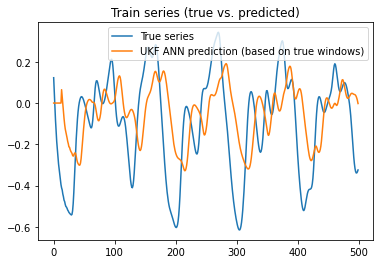

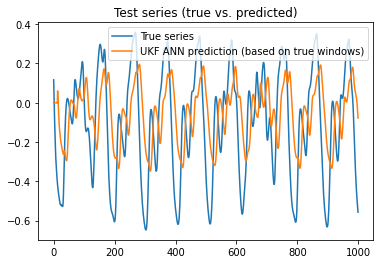

2020-07-17 17:23:31,935 [INFO] Training complete. time_to_train = 3.13 sec, 0.05 min
2020-07-17 17:23:31,936 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:31,937 [INFO] Evaluating and visualizing neural net predictions


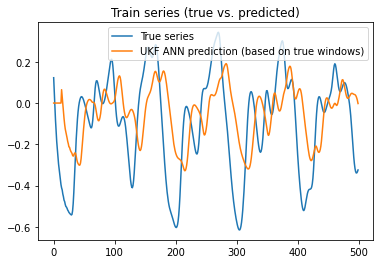

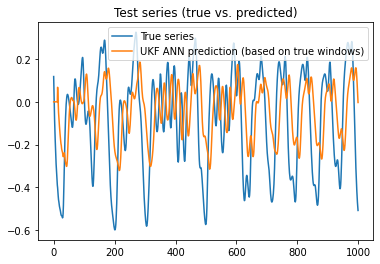

2020-07-17 17:23:33,346 [INFO] Training complete. time_to_train = 4.54 sec, 0.08 min
2020-07-17 17:23:33,347 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:33,350 [INFO] Evaluating and visualizing neural net predictions


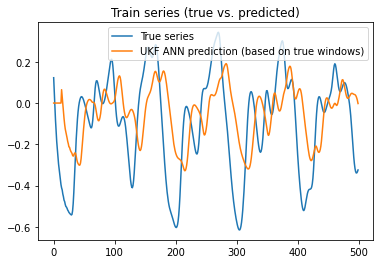

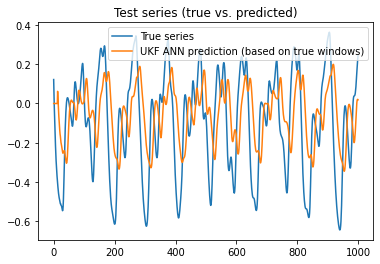

2020-07-17 17:23:34,705 [INFO] Training complete. time_to_train = 5.90 sec, 0.10 min
2020-07-17 17:23:34,706 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:34,706 [INFO] Evaluating and visualizing neural net predictions


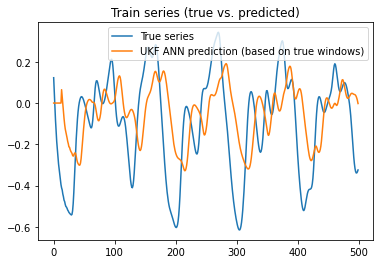

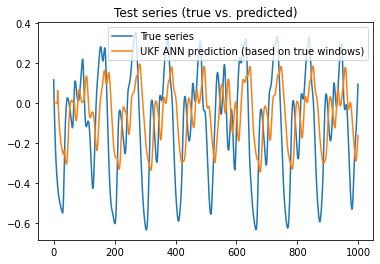

2020-07-17 17:23:36,029 [INFO] Training complete. time_to_train = 7.23 sec, 0.12 min
2020-07-17 17:23:36,031 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:36,032 [INFO] Evaluating and visualizing neural net predictions


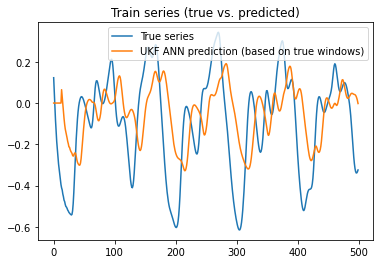

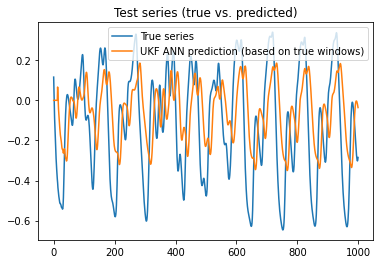

2020-07-17 17:23:37,377 [INFO] Training complete. time_to_train = 8.58 sec, 0.14 min
2020-07-17 17:23:37,378 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:37,379 [INFO] Evaluating and visualizing neural net predictions


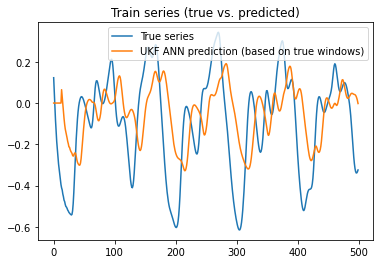

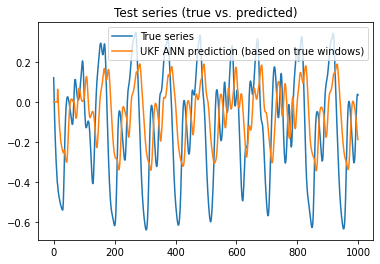

2020-07-17 17:23:38,719 [INFO] Training complete. time_to_train = 9.92 sec, 0.17 min
2020-07-17 17:23:38,720 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:38,720 [INFO] Evaluating and visualizing neural net predictions


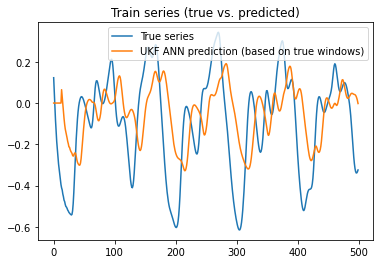

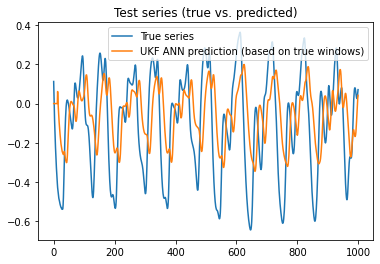

2020-07-17 17:23:40,199 [INFO] Training complete. time_to_train = 11.40 sec, 0.19 min
2020-07-17 17:23:40,200 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:40,201 [INFO] Evaluating and visualizing neural net predictions


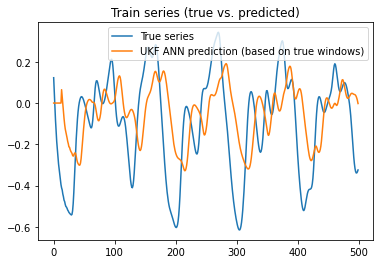

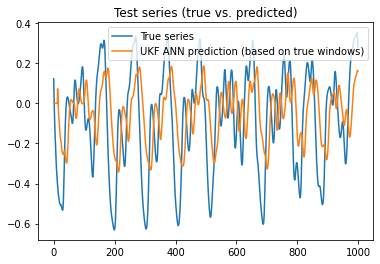

2020-07-17 17:23:41,568 [INFO] Training complete. time_to_train = 12.77 sec, 0.21 min
2020-07-17 17:23:41,569 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:41,570 [INFO] Evaluating and visualizing neural net predictions


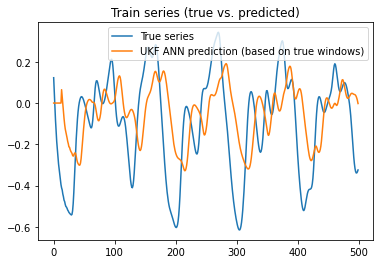

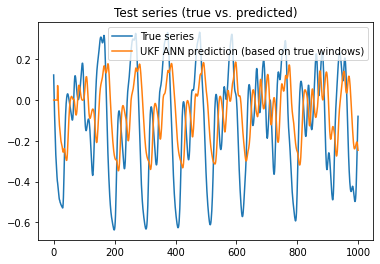

2020-07-17 17:23:42,923 [INFO] Training complete. time_to_train = 14.12 sec, 0.24 min
2020-07-17 17:23:42,924 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:42,925 [INFO] Evaluating and visualizing neural net predictions


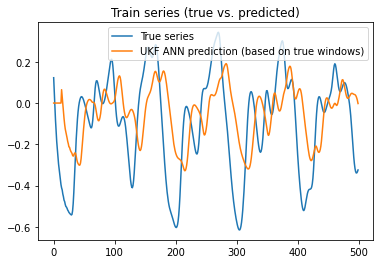

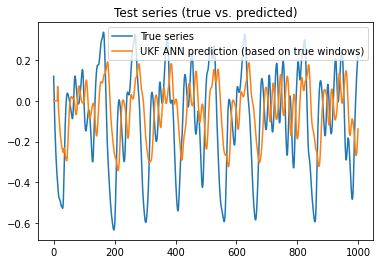

2020-07-17 17:23:44,259 [INFO] Training complete. time_to_train = 15.46 sec, 0.26 min
2020-07-17 17:23:44,260 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:44,260 [INFO] Evaluating and visualizing neural net predictions


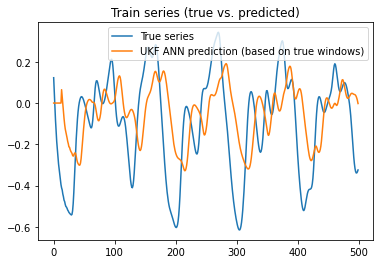

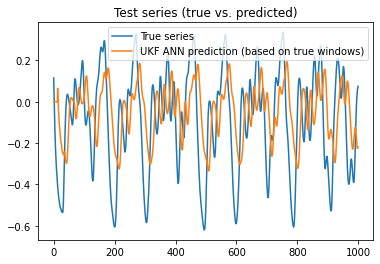

2020-07-17 17:23:45,621 [INFO] Training complete. time_to_train = 16.82 sec, 0.28 min
2020-07-17 17:23:45,622 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:45,622 [INFO] Evaluating and visualizing neural net predictions


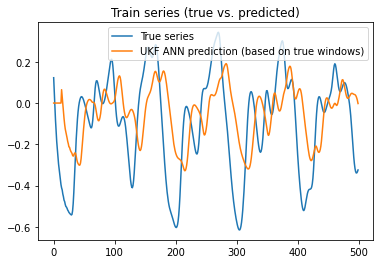

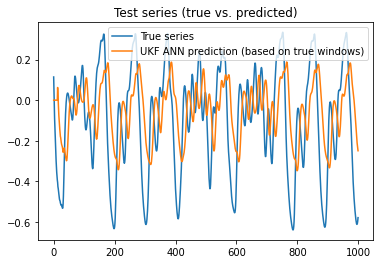

2020-07-17 17:23:46,963 [INFO] Training complete. time_to_train = 18.16 sec, 0.30 min
2020-07-17 17:23:46,963 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:46,968 [INFO] Evaluating and visualizing neural net predictions


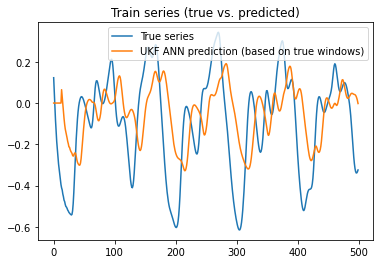

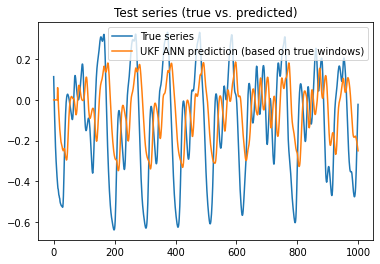

2020-07-17 17:23:48,323 [INFO] Training complete. time_to_train = 19.52 sec, 0.33 min
2020-07-17 17:23:48,324 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:48,326 [INFO] Evaluating and visualizing neural net predictions


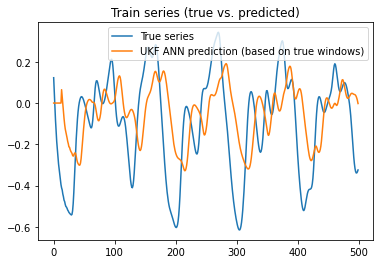

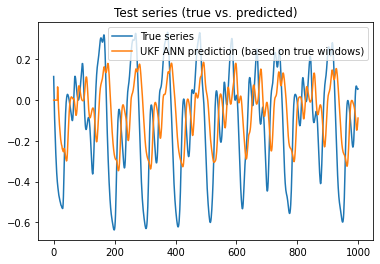

2020-07-17 17:23:49,679 [INFO] Training complete. time_to_train = 20.88 sec, 0.35 min
2020-07-17 17:23:49,679 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:49,680 [INFO] Evaluating and visualizing neural net predictions


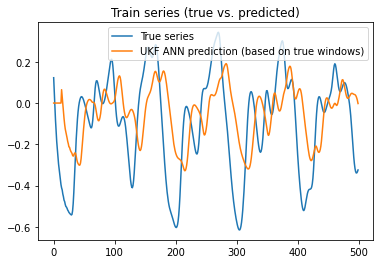

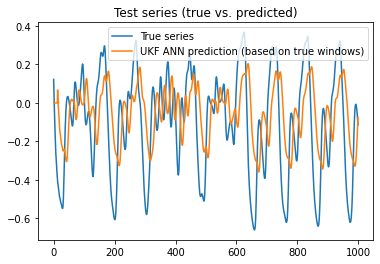

2020-07-17 17:23:51,013 [INFO] Training complete. time_to_train = 22.21 sec, 0.37 min
2020-07-17 17:23:51,014 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:51,018 [INFO] Evaluating and visualizing neural net predictions


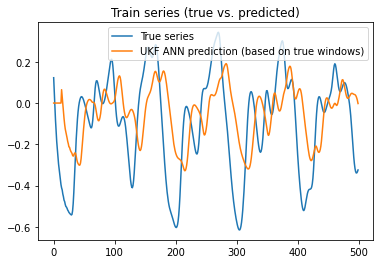

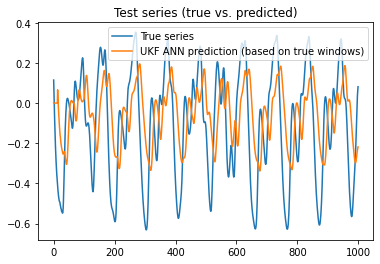

2020-07-17 17:23:52,384 [INFO] Training complete. time_to_train = 23.58 sec, 0.39 min
2020-07-17 17:23:52,385 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:52,385 [INFO] Evaluating and visualizing neural net predictions


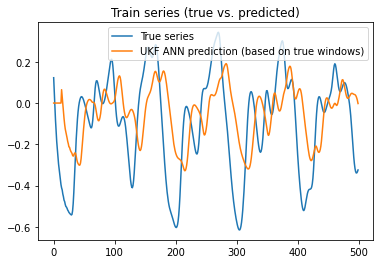

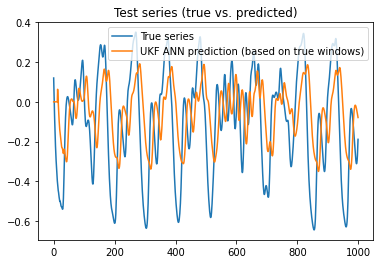

2020-07-17 17:23:53,717 [INFO] Training complete. time_to_train = 24.92 sec, 0.42 min
2020-07-17 17:23:53,718 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:53,722 [INFO] Evaluating and visualizing neural net predictions


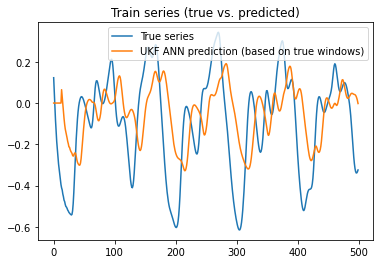

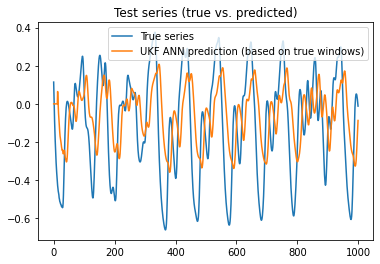

2020-07-17 17:23:55,063 [INFO] Training complete. time_to_train = 26.26 sec, 0.44 min
2020-07-17 17:23:55,063 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:55,067 [INFO] Evaluating and visualizing neural net predictions


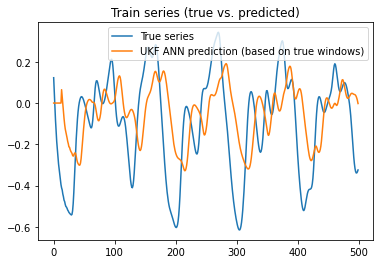

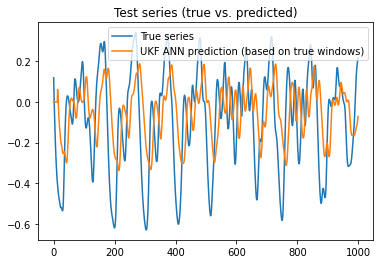

2020-07-17 17:23:56,401 [INFO] Training complete. time_to_train = 27.60 sec, 0.46 min
2020-07-17 17:23:56,404 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:56,405 [INFO] Evaluating and visualizing neural net predictions


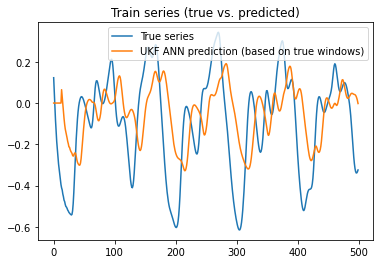

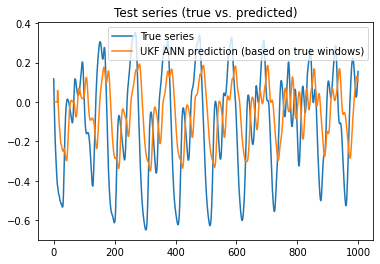

2020-07-17 17:23:57,752 [INFO] Training complete. time_to_train = 28.95 sec, 0.48 min
2020-07-17 17:23:57,753 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:57,753 [INFO] Evaluating and visualizing neural net predictions


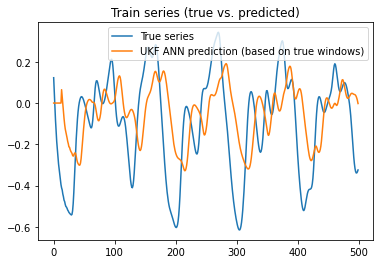

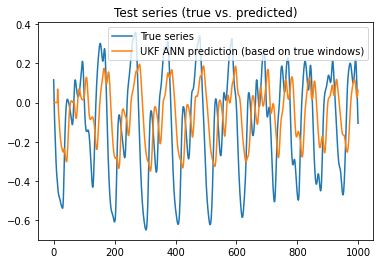

2020-07-17 17:23:59,236 [INFO] Training complete. time_to_train = 30.43 sec, 0.51 min
2020-07-17 17:23:59,239 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:23:59,239 [INFO] Evaluating and visualizing neural net predictions


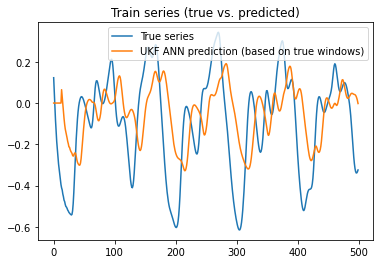

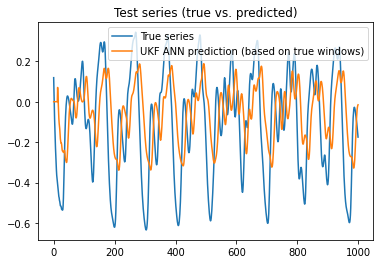

2020-07-17 17:24:00,591 [INFO] Training complete. time_to_train = 31.79 sec, 0.53 min
2020-07-17 17:24:00,595 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:00,597 [INFO] Evaluating and visualizing neural net predictions


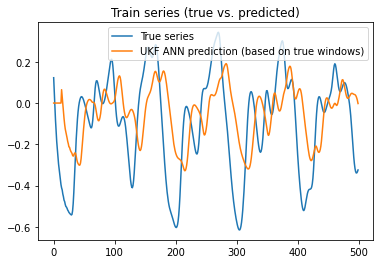

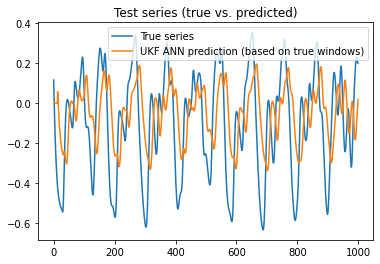

2020-07-17 17:24:01,955 [INFO] Training complete. time_to_train = 33.15 sec, 0.55 min
2020-07-17 17:24:01,956 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:01,959 [INFO] Evaluating and visualizing neural net predictions


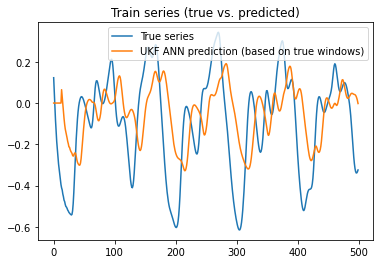

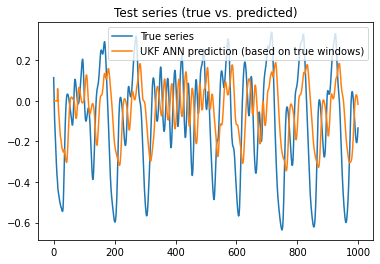

2020-07-17 17:24:03,328 [INFO] Training complete. time_to_train = 34.53 sec, 0.58 min
2020-07-17 17:24:03,329 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:03,332 [INFO] Evaluating and visualizing neural net predictions


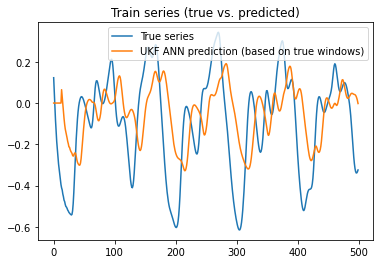

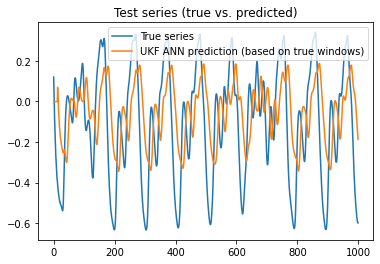

2020-07-17 17:24:04,712 [INFO] Training complete. time_to_train = 35.91 sec, 0.60 min
2020-07-17 17:24:04,712 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:04,716 [INFO] Evaluating and visualizing neural net predictions


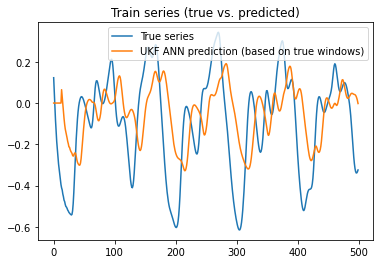

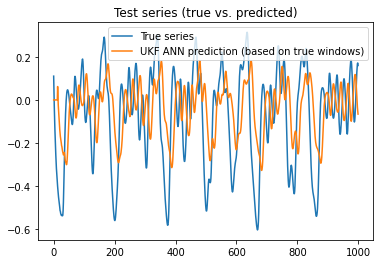

2020-07-17 17:24:06,078 [INFO] Training complete. time_to_train = 37.28 sec, 0.62 min
2020-07-17 17:24:06,078 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:06,082 [INFO] Evaluating and visualizing neural net predictions


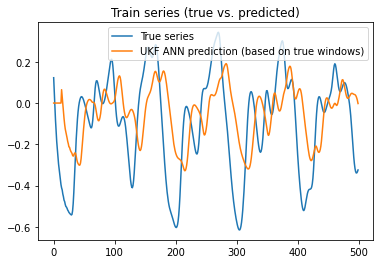

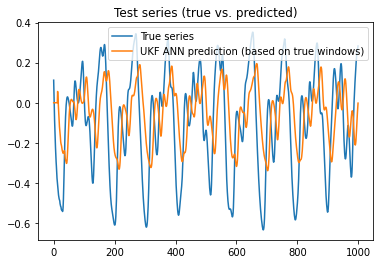

2020-07-17 17:24:07,438 [INFO] Training complete. time_to_train = 38.64 sec, 0.64 min
2020-07-17 17:24:07,440 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:07,441 [INFO] Evaluating and visualizing neural net predictions


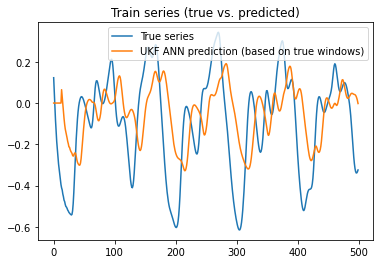

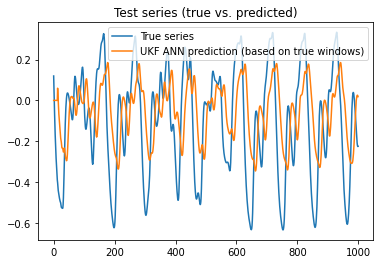

2020-07-17 17:24:08,806 [INFO] Training complete. time_to_train = 40.00 sec, 0.67 min
2020-07-17 17:24:08,806 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:08,807 [INFO] Evaluating and visualizing neural net predictions


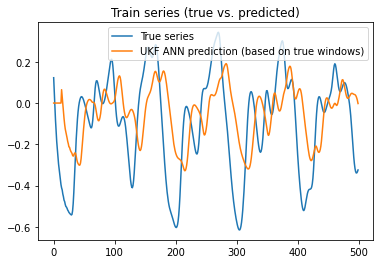

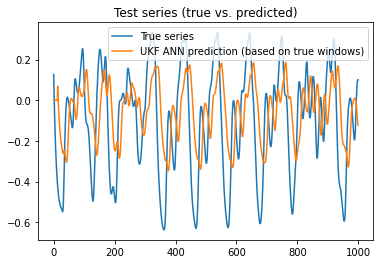

2020-07-17 17:24:10,189 [INFO] Training complete. time_to_train = 41.39 sec, 0.69 min
2020-07-17 17:24:10,189 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:10,190 [INFO] Evaluating and visualizing neural net predictions


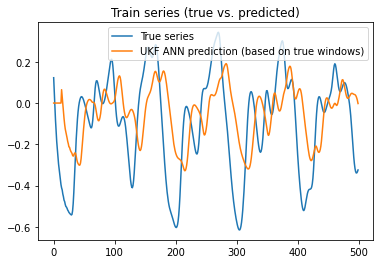

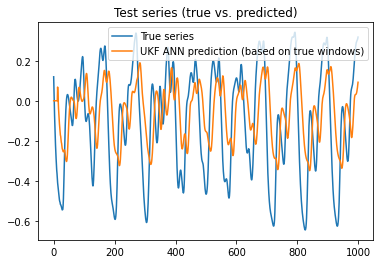

2020-07-17 17:24:11,543 [INFO] Training complete. time_to_train = 42.74 sec, 0.71 min
2020-07-17 17:24:11,544 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:11,547 [INFO] Evaluating and visualizing neural net predictions


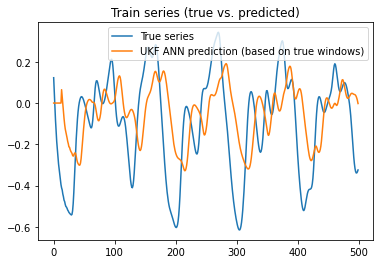

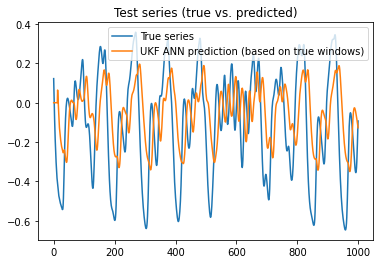

2020-07-17 17:24:12,950 [INFO] Training complete. time_to_train = 44.15 sec, 0.74 min
2020-07-17 17:24:12,951 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:12,951 [INFO] Evaluating and visualizing neural net predictions


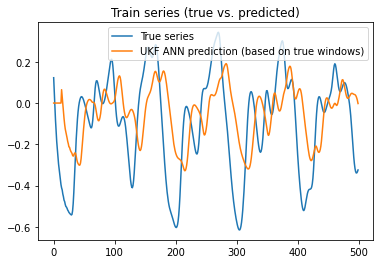

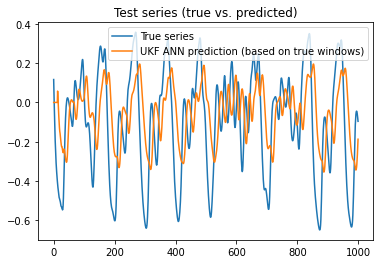

2020-07-17 17:24:14,285 [INFO] Training complete. time_to_train = 45.48 sec, 0.76 min
2020-07-17 17:24:14,285 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:14,289 [INFO] Evaluating and visualizing neural net predictions


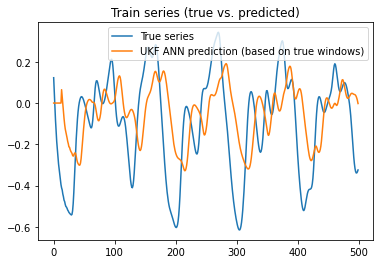

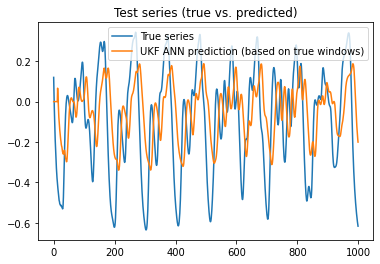

2020-07-17 17:24:15,621 [INFO] Training complete. time_to_train = 46.82 sec, 0.78 min
2020-07-17 17:24:15,622 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:15,623 [INFO] Evaluating and visualizing neural net predictions


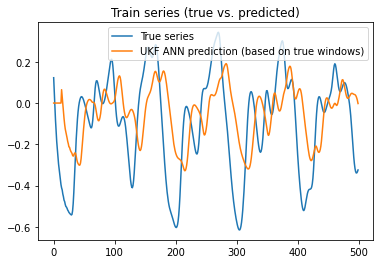

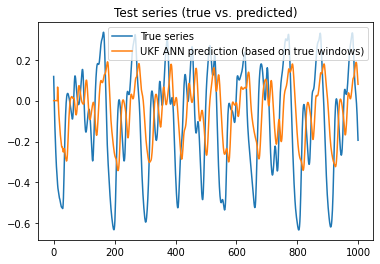

2020-07-17 17:24:16,964 [INFO] Training complete. time_to_train = 48.16 sec, 0.80 min
2020-07-17 17:24:16,965 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:16,968 [INFO] Evaluating and visualizing neural net predictions


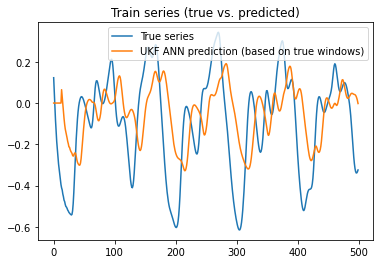

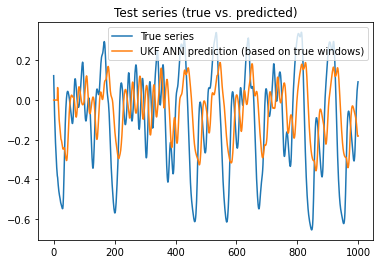

2020-07-17 17:24:18,302 [INFO] Training complete. time_to_train = 49.50 sec, 0.83 min
2020-07-17 17:24:18,303 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:18,304 [INFO] Evaluating and visualizing neural net predictions


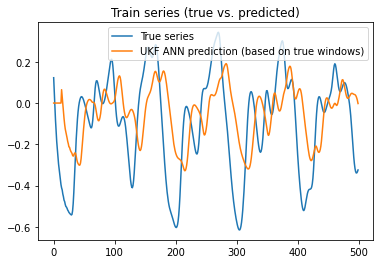

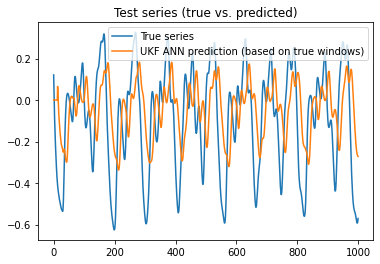

2020-07-17 17:24:19,662 [INFO] Training complete. time_to_train = 50.86 sec, 0.85 min
2020-07-17 17:24:19,663 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:19,665 [INFO] Evaluating and visualizing neural net predictions


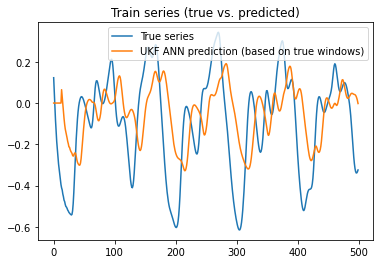

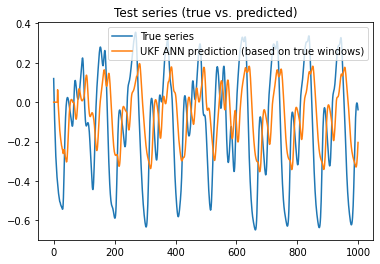

2020-07-17 17:24:21,163 [INFO] Training complete. time_to_train = 52.36 sec, 0.87 min
2020-07-17 17:24:21,164 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:21,165 [INFO] Evaluating and visualizing neural net predictions


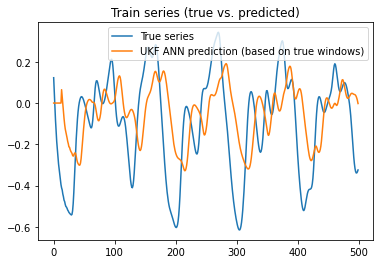

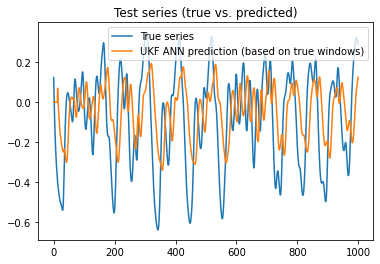

2020-07-17 17:24:22,533 [INFO] Training complete. time_to_train = 53.73 sec, 0.90 min
2020-07-17 17:24:22,534 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:22,535 [INFO] Evaluating and visualizing neural net predictions


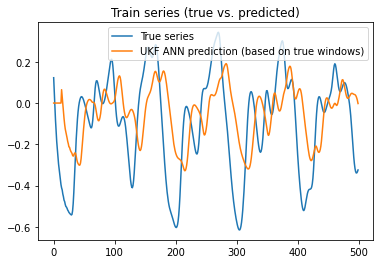

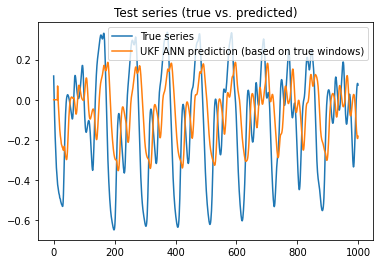

2020-07-17 17:24:23,898 [INFO] Training complete. time_to_train = 55.10 sec, 0.92 min
2020-07-17 17:24:23,899 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:23,900 [INFO] Evaluating and visualizing neural net predictions


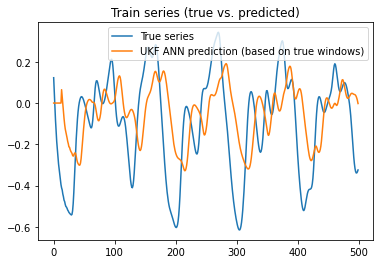

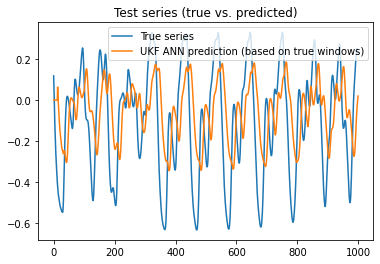

2020-07-17 17:24:25,240 [INFO] Training complete. time_to_train = 56.44 sec, 0.94 min
2020-07-17 17:24:25,241 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:25,242 [INFO] Evaluating and visualizing neural net predictions


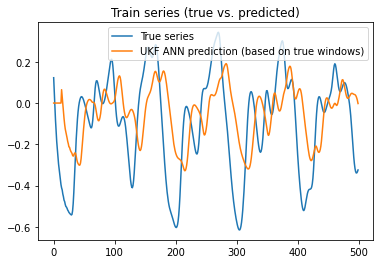

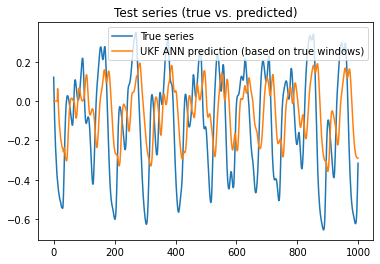

2020-07-17 17:24:26,585 [INFO] Training complete. time_to_train = 57.78 sec, 0.96 min
2020-07-17 17:24:26,586 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:26,587 [INFO] Evaluating and visualizing neural net predictions


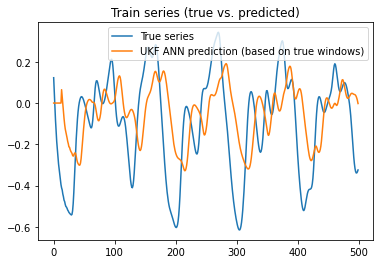

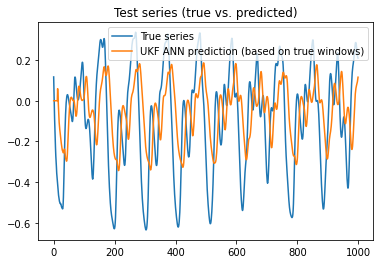

2020-07-17 17:24:27,916 [INFO] Training complete. time_to_train = 59.11 sec, 0.99 min
2020-07-17 17:24:27,917 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:27,917 [INFO] Evaluating and visualizing neural net predictions


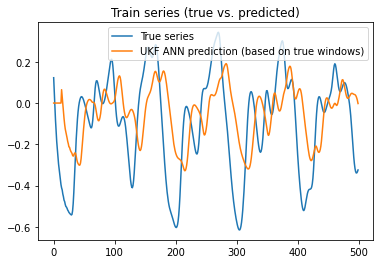

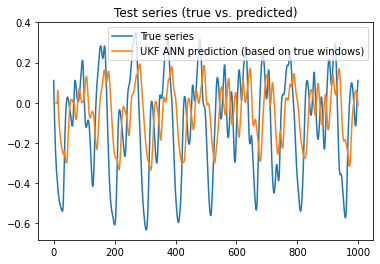

2020-07-17 17:24:29,323 [INFO] Training complete. time_to_train = 60.52 sec, 1.01 min
2020-07-17 17:24:29,324 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:29,326 [INFO] Evaluating and visualizing neural net predictions


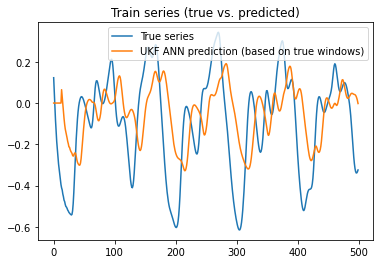

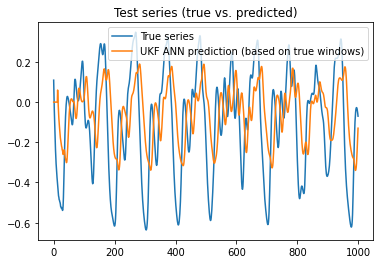

2020-07-17 17:24:30,661 [INFO] Training complete. time_to_train = 61.86 sec, 1.03 min
2020-07-17 17:24:30,662 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:30,663 [INFO] Evaluating and visualizing neural net predictions


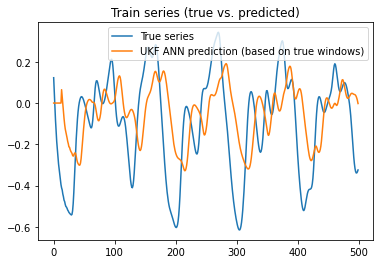

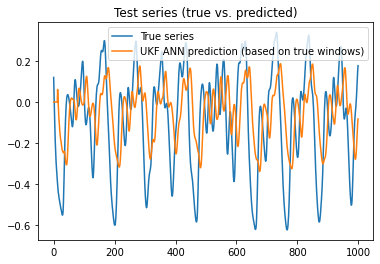

2020-07-17 17:24:31,999 [INFO] Training complete. time_to_train = 63.20 sec, 1.05 min
2020-07-17 17:24:32,000 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:32,007 [INFO] Evaluating and visualizing neural net predictions


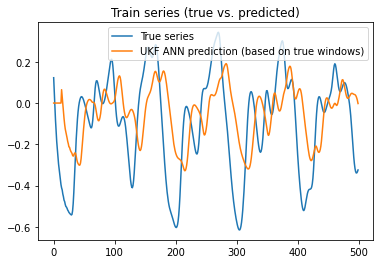

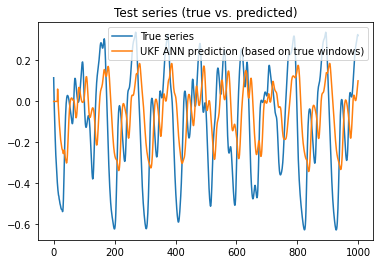

2020-07-17 17:24:33,373 [INFO] Training complete. time_to_train = 64.57 sec, 1.08 min
2020-07-17 17:24:33,374 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:33,375 [INFO] Evaluating and visualizing neural net predictions


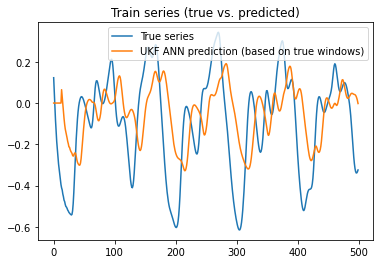

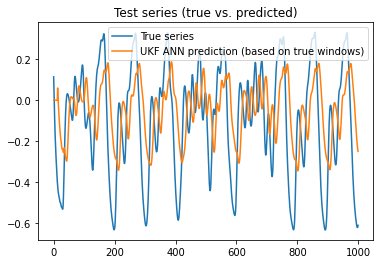

2020-07-17 17:24:34,709 [INFO] Training complete. time_to_train = 65.91 sec, 1.10 min
2020-07-17 17:24:34,712 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:34,712 [INFO] Evaluating and visualizing neural net predictions


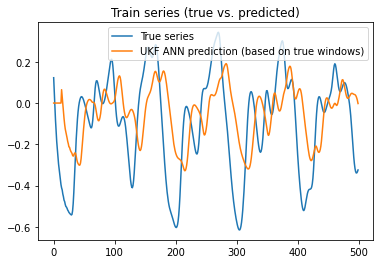

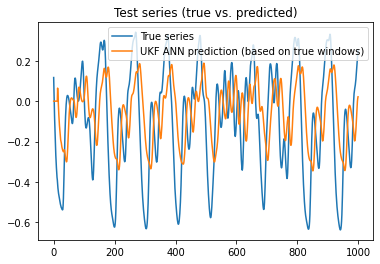

2020-07-17 17:24:36,039 [INFO] Training complete. time_to_train = 67.24 sec, 1.12 min
2020-07-17 17:24:36,040 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:36,043 [INFO] Evaluating and visualizing neural net predictions


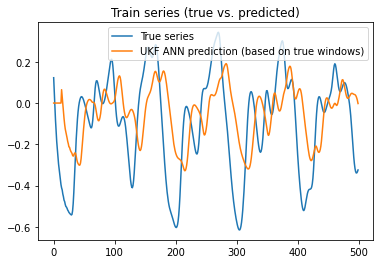

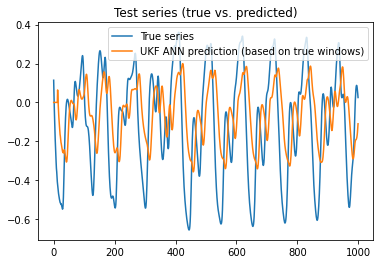

2020-07-17 17:24:37,384 [INFO] Training complete. time_to_train = 68.58 sec, 1.14 min
2020-07-17 17:24:37,386 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:37,388 [INFO] Evaluating and visualizing neural net predictions


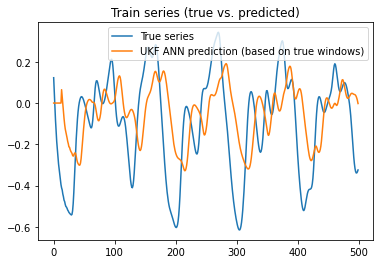

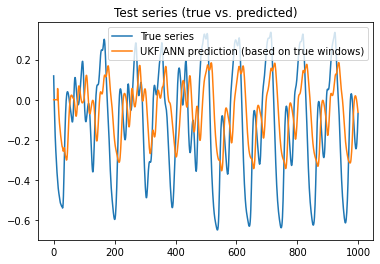

2020-07-17 17:24:38,716 [INFO] Training complete. time_to_train = 69.91 sec, 1.17 min
2020-07-17 17:24:38,717 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:38,718 [INFO] Evaluating and visualizing neural net predictions


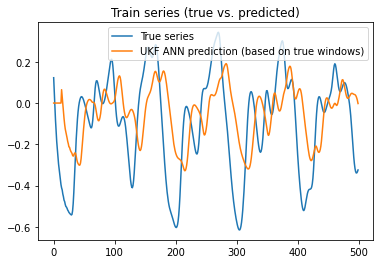

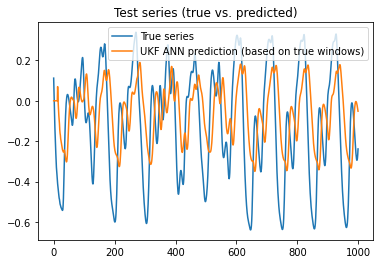

2020-07-17 17:24:40,057 [INFO] Training complete. time_to_train = 71.26 sec, 1.19 min
2020-07-17 17:24:40,058 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:40,059 [INFO] Evaluating and visualizing neural net predictions


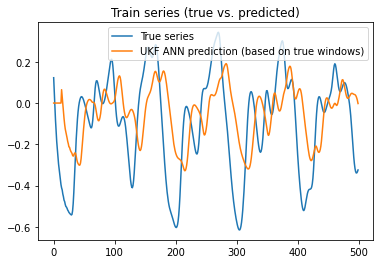

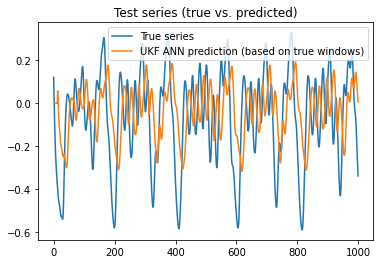

2020-07-17 17:24:41,429 [INFO] Training complete. time_to_train = 72.63 sec, 1.21 min
2020-07-17 17:24:41,430 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:41,434 [INFO] Evaluating and visualizing neural net predictions


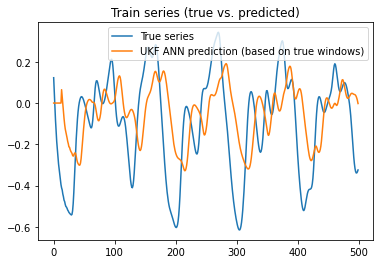

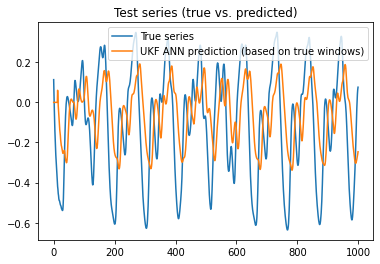

2020-07-17 17:24:42,765 [INFO] Training complete. time_to_train = 73.96 sec, 1.23 min
2020-07-17 17:24:42,765 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:42,769 [INFO] Evaluating and visualizing neural net predictions


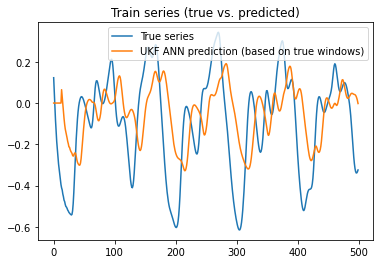

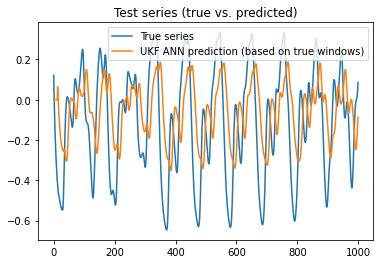

2020-07-17 17:24:44,128 [INFO] Training complete. time_to_train = 75.33 sec, 1.26 min
2020-07-17 17:24:44,129 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:44,131 [INFO] Evaluating and visualizing neural net predictions


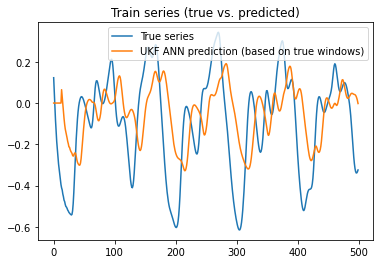

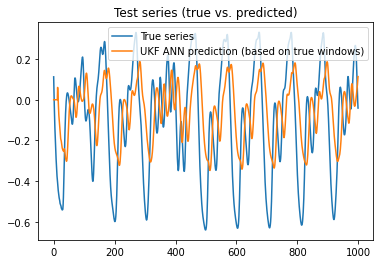

2020-07-17 17:24:45,497 [INFO] Training complete. time_to_train = 76.70 sec, 1.28 min
2020-07-17 17:24:45,498 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:45,500 [INFO] Evaluating and visualizing neural net predictions


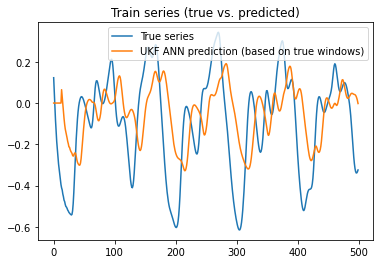

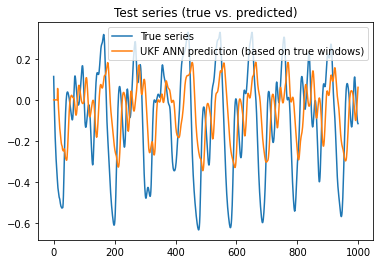

2020-07-17 17:24:46,836 [INFO] Training complete. time_to_train = 78.04 sec, 1.30 min
2020-07-17 17:24:46,837 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:46,838 [INFO] Evaluating and visualizing neural net predictions


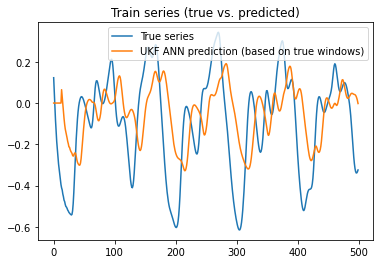

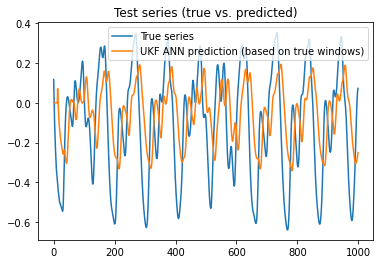

2020-07-17 17:24:48,174 [INFO] Training complete. time_to_train = 79.37 sec, 1.32 min
2020-07-17 17:24:48,177 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:48,178 [INFO] Evaluating and visualizing neural net predictions


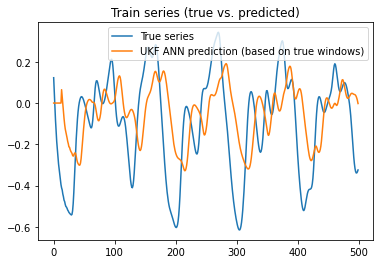

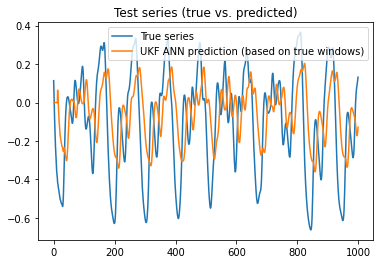

2020-07-17 17:24:49,748 [INFO] Training complete. time_to_train = 80.95 sec, 1.35 min
2020-07-17 17:24:49,748 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:49,749 [INFO] Evaluating and visualizing neural net predictions


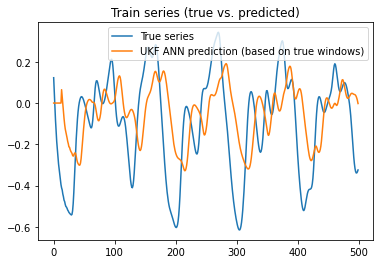

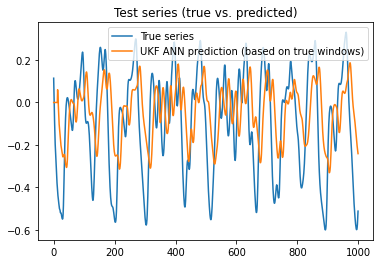

2020-07-17 17:24:51,084 [INFO] Training complete. time_to_train = 82.28 sec, 1.37 min
2020-07-17 17:24:51,085 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:51,087 [INFO] Evaluating and visualizing neural net predictions


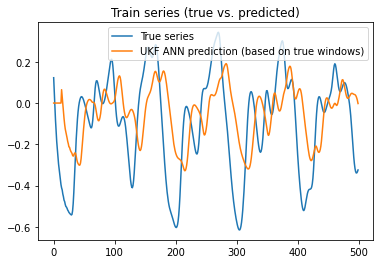

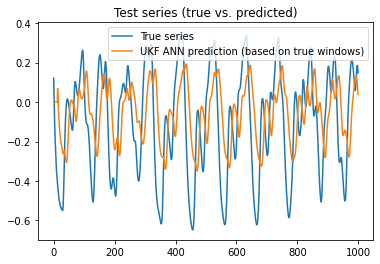

2020-07-17 17:24:52,435 [INFO] Training complete. time_to_train = 83.63 sec, 1.39 min
2020-07-17 17:24:52,436 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:52,437 [INFO] Evaluating and visualizing neural net predictions


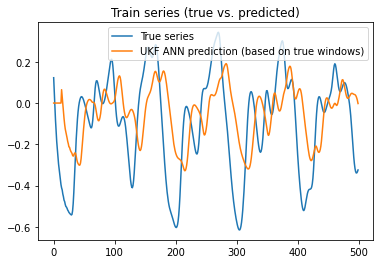

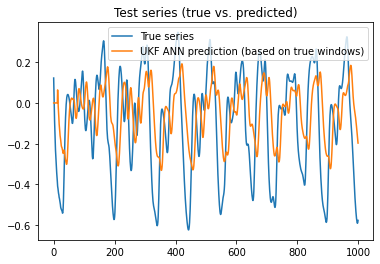

2020-07-17 17:24:53,779 [INFO] Training complete. time_to_train = 84.98 sec, 1.42 min
2020-07-17 17:24:53,780 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:53,782 [INFO] Evaluating and visualizing neural net predictions


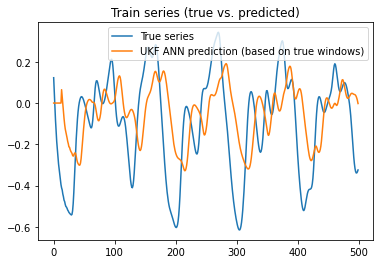

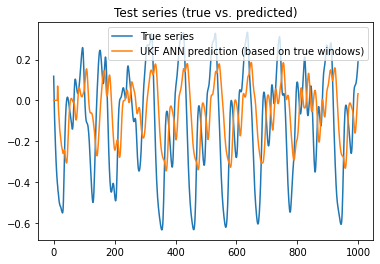

2020-07-17 17:24:55,118 [INFO] Training complete. time_to_train = 86.32 sec, 1.44 min
2020-07-17 17:24:55,119 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:55,120 [INFO] Evaluating and visualizing neural net predictions


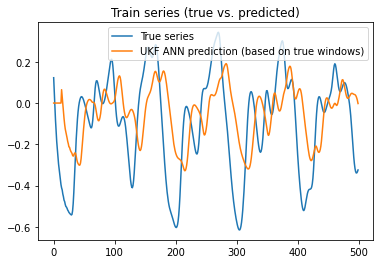

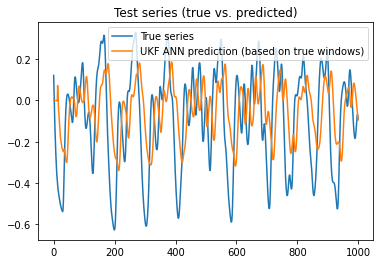

2020-07-17 17:24:56,453 [INFO] Training complete. time_to_train = 87.65 sec, 1.46 min
2020-07-17 17:24:56,457 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:56,461 [INFO] Evaluating and visualizing neural net predictions


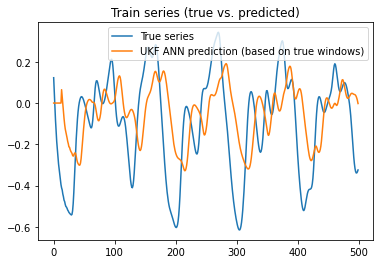

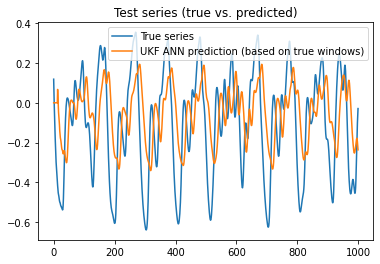

2020-07-17 17:24:57,802 [INFO] Training complete. time_to_train = 89.00 sec, 1.48 min
2020-07-17 17:24:57,804 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:57,805 [INFO] Evaluating and visualizing neural net predictions


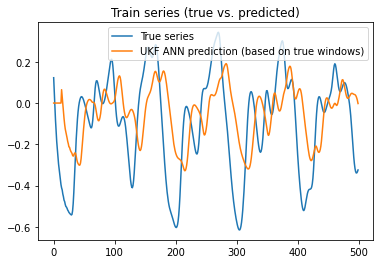

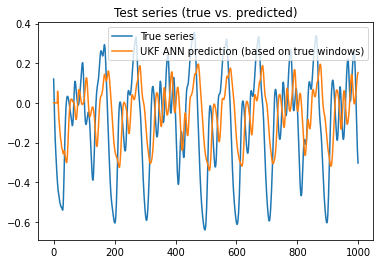

2020-07-17 17:24:59,155 [INFO] Training complete. time_to_train = 90.35 sec, 1.51 min
2020-07-17 17:24:59,156 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:24:59,157 [INFO] Evaluating and visualizing neural net predictions


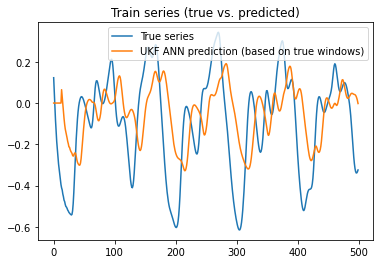

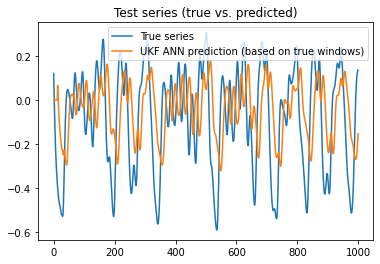

2020-07-17 17:25:00,503 [INFO] Training complete. time_to_train = 91.70 sec, 1.53 min
2020-07-17 17:25:00,504 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:00,505 [INFO] Evaluating and visualizing neural net predictions


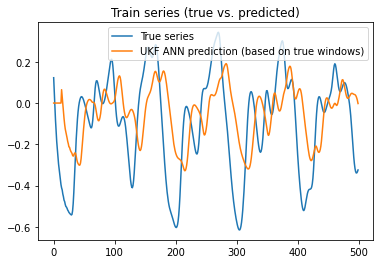

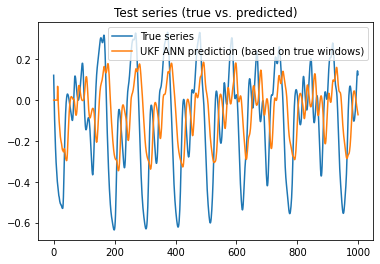

2020-07-17 17:25:01,919 [INFO] Training complete. time_to_train = 93.12 sec, 1.55 min
2020-07-17 17:25:01,920 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:01,921 [INFO] Evaluating and visualizing neural net predictions


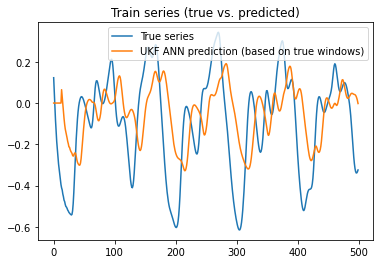

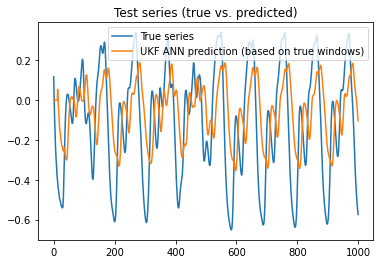

2020-07-17 17:25:03,328 [INFO] Training complete. time_to_train = 94.53 sec, 1.58 min
2020-07-17 17:25:03,329 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:03,329 [INFO] Evaluating and visualizing neural net predictions


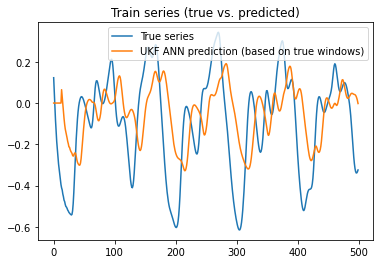

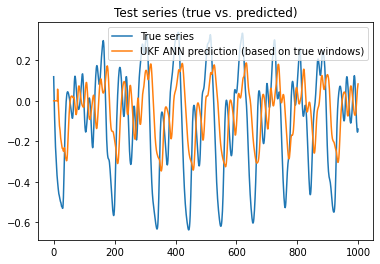

2020-07-17 17:25:04,765 [INFO] Training complete. time_to_train = 95.96 sec, 1.60 min
2020-07-17 17:25:04,766 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:04,767 [INFO] Evaluating and visualizing neural net predictions


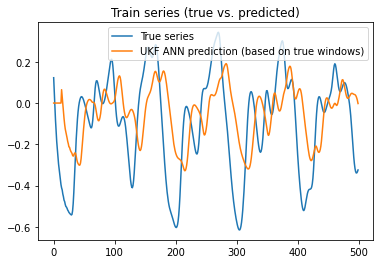

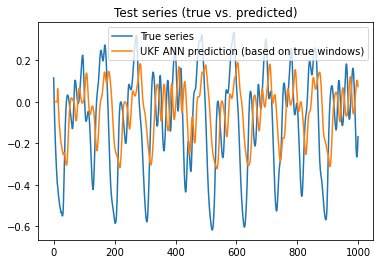

2020-07-17 17:25:06,137 [INFO] Training complete. time_to_train = 97.34 sec, 1.62 min
2020-07-17 17:25:06,138 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:06,138 [INFO] Evaluating and visualizing neural net predictions


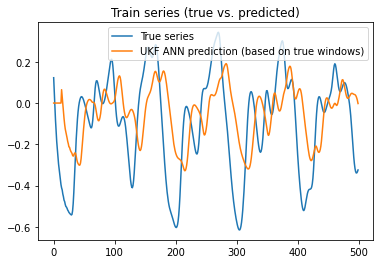

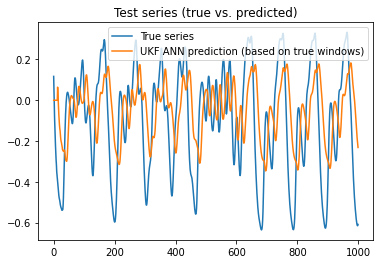

2020-07-17 17:25:07,489 [INFO] Training complete. time_to_train = 98.69 sec, 1.64 min
2020-07-17 17:25:07,490 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:07,491 [INFO] Evaluating and visualizing neural net predictions


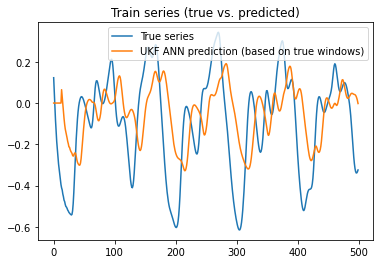

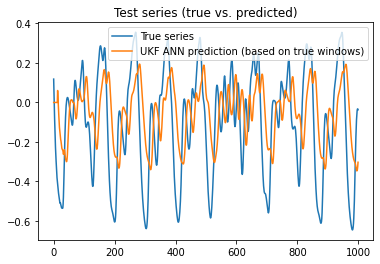

2020-07-17 17:25:08,829 [INFO] Training complete. time_to_train = 100.03 sec, 1.67 min
2020-07-17 17:25:08,829 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:08,833 [INFO] Evaluating and visualizing neural net predictions


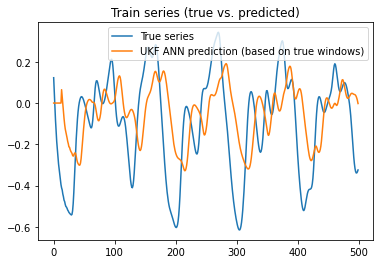

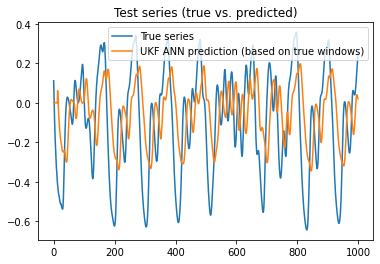

2020-07-17 17:25:10,187 [INFO] Training complete. time_to_train = 101.39 sec, 1.69 min
2020-07-17 17:25:10,189 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:10,190 [INFO] Evaluating and visualizing neural net predictions


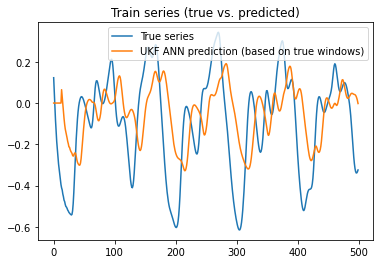

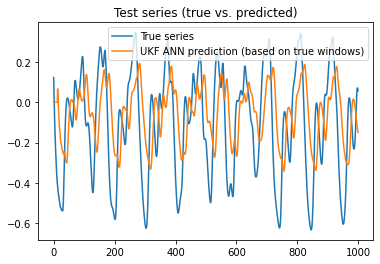

2020-07-17 17:25:11,518 [INFO] Training complete. time_to_train = 102.72 sec, 1.71 min
2020-07-17 17:25:11,518 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:11,522 [INFO] Evaluating and visualizing neural net predictions


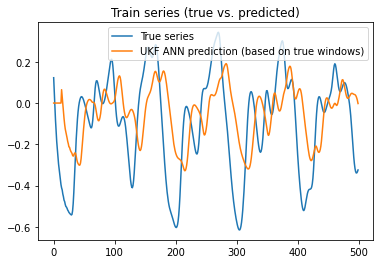

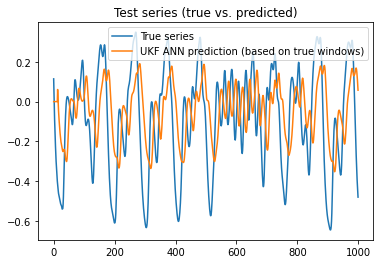

2020-07-17 17:25:12,858 [INFO] Training complete. time_to_train = 104.06 sec, 1.73 min
2020-07-17 17:25:12,861 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:12,862 [INFO] Evaluating and visualizing neural net predictions


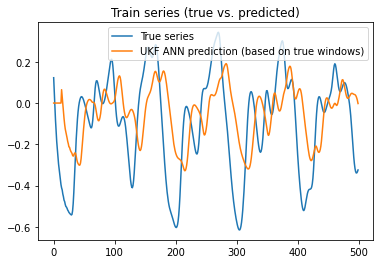

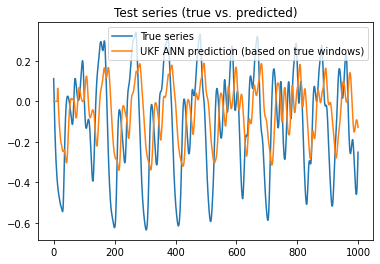

2020-07-17 17:25:14,227 [INFO] Training complete. time_to_train = 105.43 sec, 1.76 min
2020-07-17 17:25:14,228 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:14,229 [INFO] Evaluating and visualizing neural net predictions


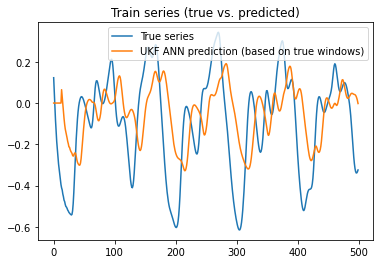

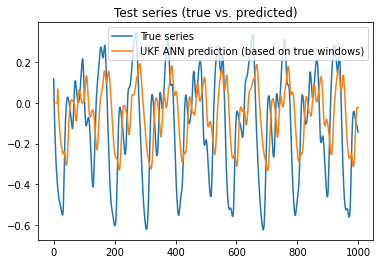

2020-07-17 17:25:15,551 [INFO] Training complete. time_to_train = 106.75 sec, 1.78 min
2020-07-17 17:25:15,552 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:15,554 [INFO] Evaluating and visualizing neural net predictions


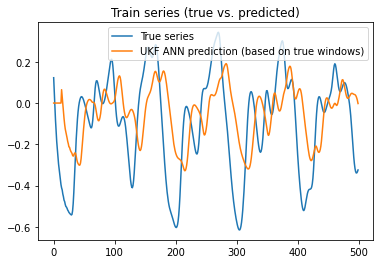

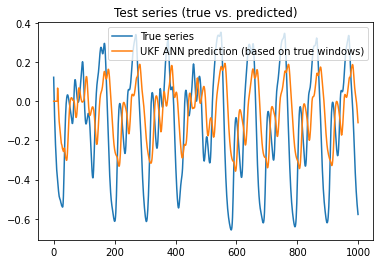

2020-07-17 17:25:16,888 [INFO] Training complete. time_to_train = 108.09 sec, 1.80 min
2020-07-17 17:25:16,889 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:16,890 [INFO] Evaluating and visualizing neural net predictions


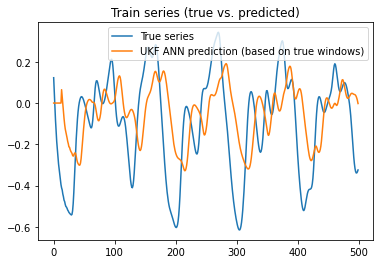

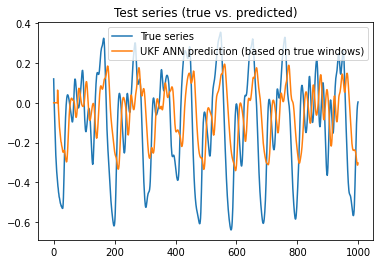

2020-07-17 17:25:18,250 [INFO] Training complete. time_to_train = 109.45 sec, 1.82 min
2020-07-17 17:25:18,250 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:18,252 [INFO] Evaluating and visualizing neural net predictions


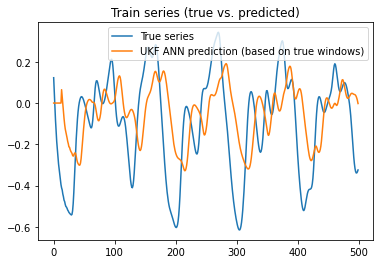

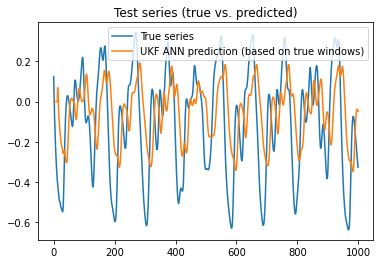

2020-07-17 17:25:19,571 [INFO] Training complete. time_to_train = 110.77 sec, 1.85 min
2020-07-17 17:25:19,571 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:19,572 [INFO] Evaluating and visualizing neural net predictions


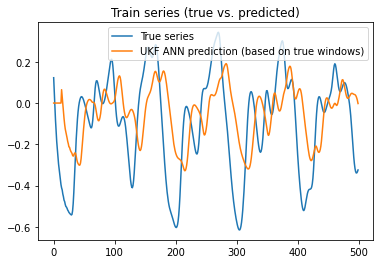

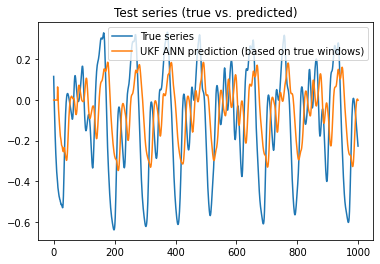

2020-07-17 17:25:20,923 [INFO] Training complete. time_to_train = 112.12 sec, 1.87 min
2020-07-17 17:25:20,924 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:20,928 [INFO] Evaluating and visualizing neural net predictions


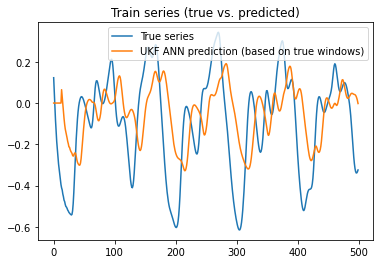

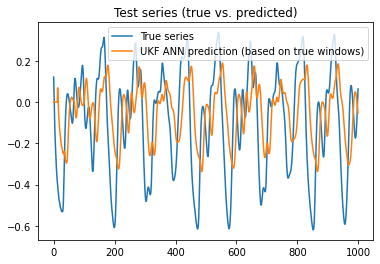

2020-07-17 17:25:22,267 [INFO] Training complete. time_to_train = 113.47 sec, 1.89 min
2020-07-17 17:25:22,269 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:22,270 [INFO] Evaluating and visualizing neural net predictions


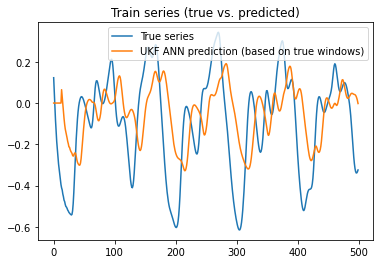

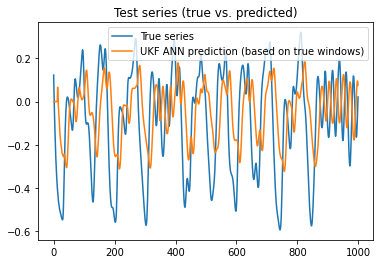

2020-07-17 17:25:23,856 [INFO] Training complete. time_to_train = 115.06 sec, 1.92 min
2020-07-17 17:25:23,857 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:23,858 [INFO] Evaluating and visualizing neural net predictions


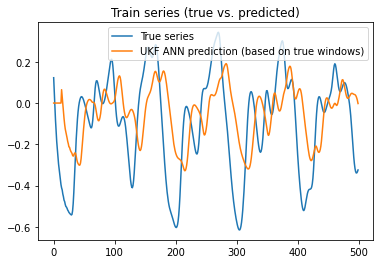

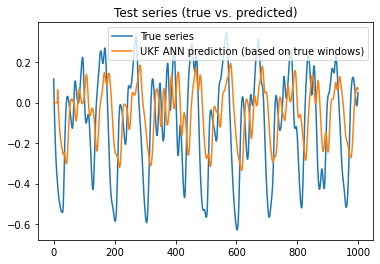

2020-07-17 17:25:25,230 [INFO] Training complete. time_to_train = 116.43 sec, 1.94 min
2020-07-17 17:25:25,232 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:25,233 [INFO] Evaluating and visualizing neural net predictions


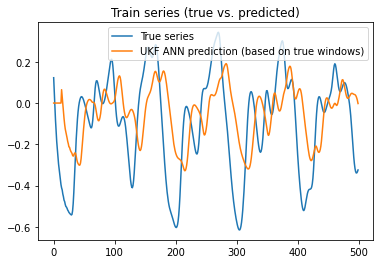

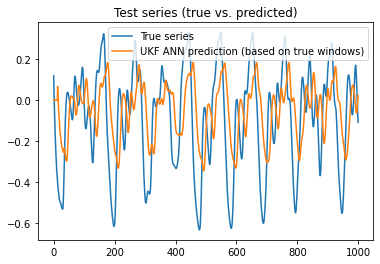

2020-07-17 17:25:26,630 [INFO] Training complete. time_to_train = 117.83 sec, 1.96 min
2020-07-17 17:25:26,631 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:26,632 [INFO] Evaluating and visualizing neural net predictions


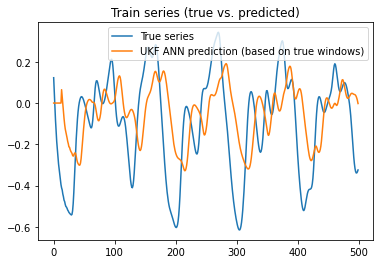

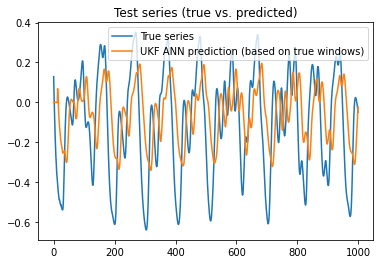

2020-07-17 17:25:27,987 [INFO] Training complete. time_to_train = 119.19 sec, 1.99 min
2020-07-17 17:25:27,988 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:27,992 [INFO] Evaluating and visualizing neural net predictions


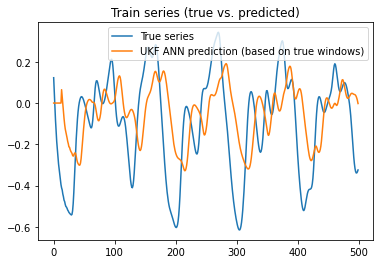

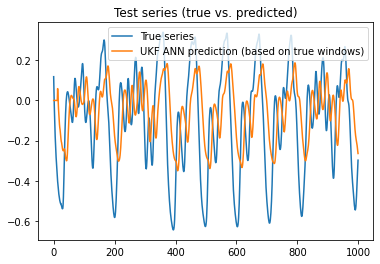

2020-07-17 17:25:29,350 [INFO] Training complete. time_to_train = 120.55 sec, 2.01 min
2020-07-17 17:25:29,352 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:29,353 [INFO] Evaluating and visualizing neural net predictions


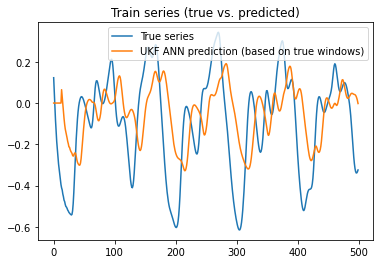

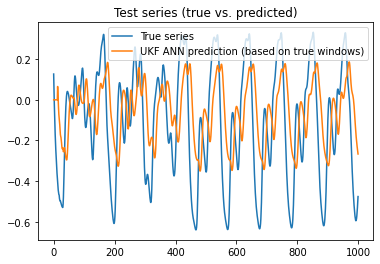

2020-07-17 17:25:30,706 [INFO] Training complete. time_to_train = 121.90 sec, 2.03 min
2020-07-17 17:25:30,706 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:30,707 [INFO] Evaluating and visualizing neural net predictions


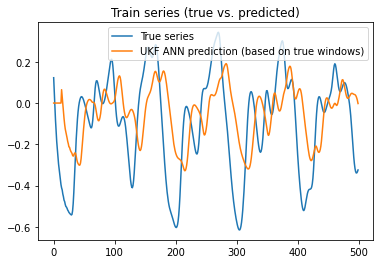

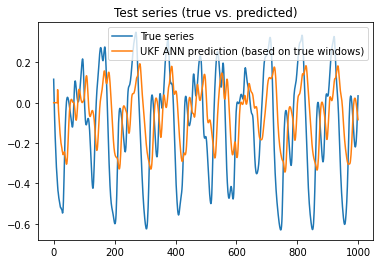

2020-07-17 17:25:32,066 [INFO] Training complete. time_to_train = 123.26 sec, 2.05 min
2020-07-17 17:25:32,066 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:32,067 [INFO] Evaluating and visualizing neural net predictions


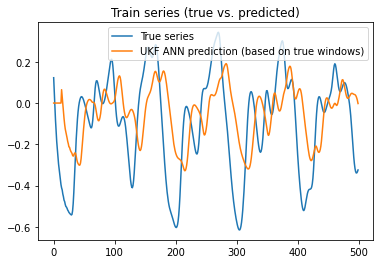

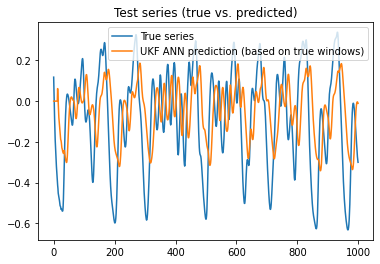

2020-07-17 17:25:33,451 [INFO] Training complete. time_to_train = 124.65 sec, 2.08 min
2020-07-17 17:25:33,452 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:33,452 [INFO] Evaluating and visualizing neural net predictions


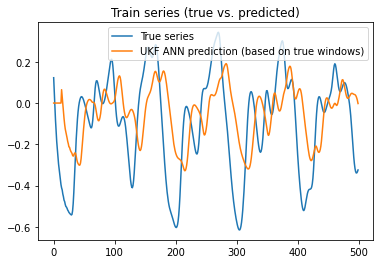

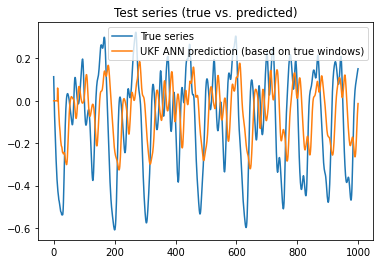

2020-07-17 17:25:34,804 [INFO] Training complete. time_to_train = 126.00 sec, 2.10 min
2020-07-17 17:25:34,805 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:34,809 [INFO] Evaluating and visualizing neural net predictions


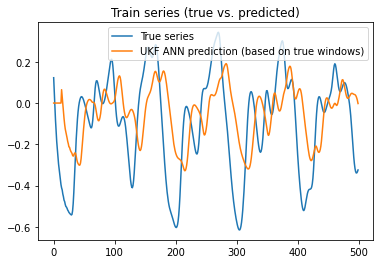

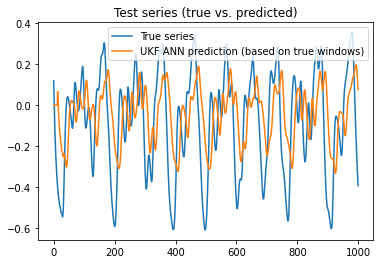

2020-07-17 17:25:36,157 [INFO] Training complete. time_to_train = 127.36 sec, 2.12 min
2020-07-17 17:25:36,158 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:36,158 [INFO] Evaluating and visualizing neural net predictions


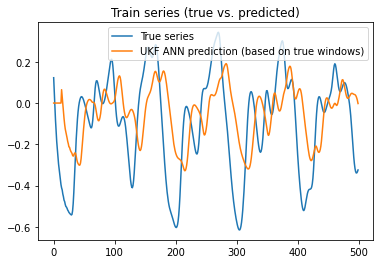

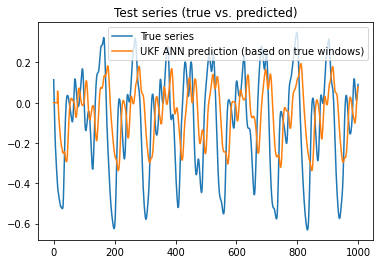

2020-07-17 17:25:37,504 [INFO] Training complete. time_to_train = 128.70 sec, 2.15 min
2020-07-17 17:25:37,505 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:37,506 [INFO] Evaluating and visualizing neural net predictions


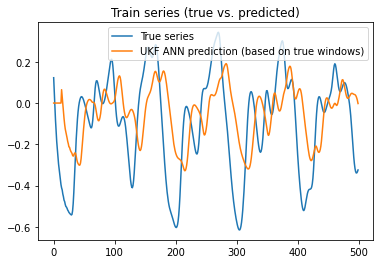

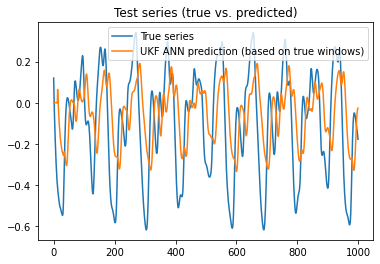

2020-07-17 17:25:38,830 [INFO] Training complete. time_to_train = 130.03 sec, 2.17 min
2020-07-17 17:25:38,831 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:38,831 [INFO] Evaluating and visualizing neural net predictions


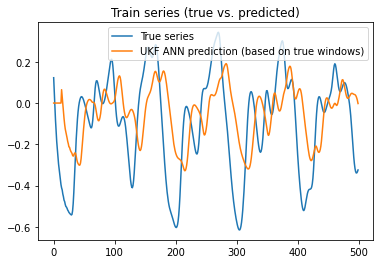

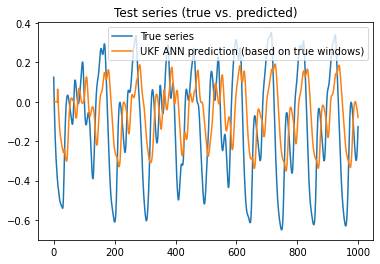

2020-07-17 17:25:40,179 [INFO] Training complete. time_to_train = 131.38 sec, 2.19 min
2020-07-17 17:25:40,181 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:40,183 [INFO] Evaluating and visualizing neural net predictions


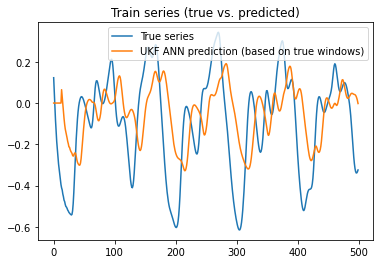

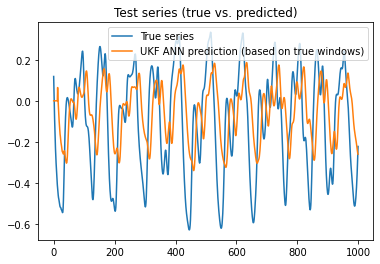

2020-07-17 17:25:41,555 [INFO] Training complete. time_to_train = 132.75 sec, 2.21 min
2020-07-17 17:25:41,558 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:41,559 [INFO] Evaluating and visualizing neural net predictions


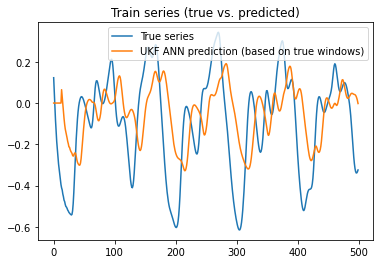

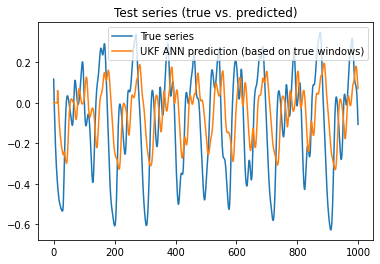

2020-07-17 17:25:42,905 [INFO] Training complete. time_to_train = 134.10 sec, 2.24 min
2020-07-17 17:25:42,906 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:42,910 [INFO] Evaluating and visualizing neural net predictions


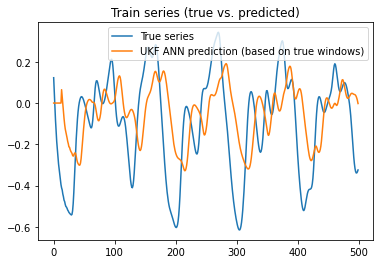

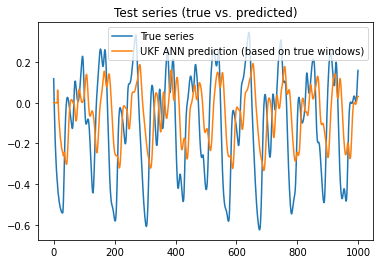

2020-07-17 17:25:44,226 [INFO] Training complete. time_to_train = 135.43 sec, 2.26 min
2020-07-17 17:25:44,227 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:44,231 [INFO] Evaluating and visualizing neural net predictions


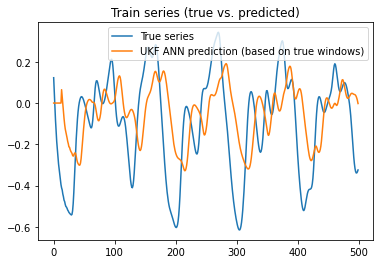

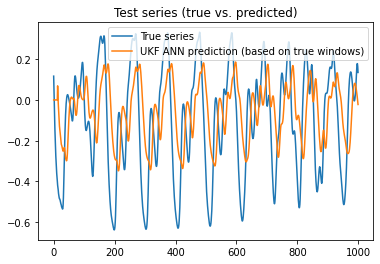

2020-07-17 17:25:45,595 [INFO] Training complete. time_to_train = 136.79 sec, 2.28 min
2020-07-17 17:25:45,597 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:45,598 [INFO] Evaluating and visualizing neural net predictions


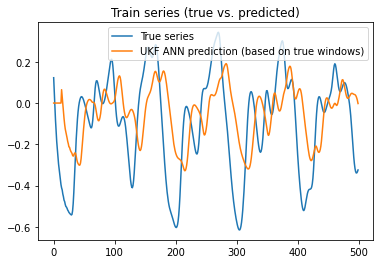

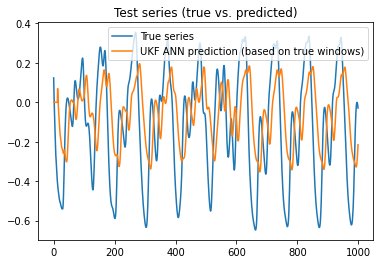

2020-07-17 17:25:46,933 [INFO] Training complete. time_to_train = 138.13 sec, 2.30 min
2020-07-17 17:25:46,934 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:46,935 [INFO] Evaluating and visualizing neural net predictions


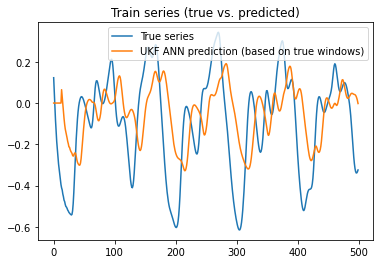

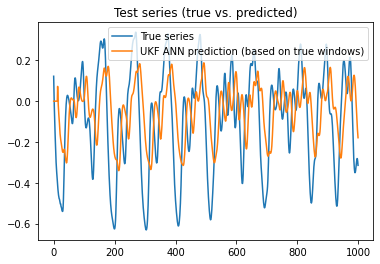

2020-07-17 17:25:48,259 [INFO] Training complete. time_to_train = 139.46 sec, 2.32 min
2020-07-17 17:25:48,260 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:48,260 [INFO] Evaluating and visualizing neural net predictions


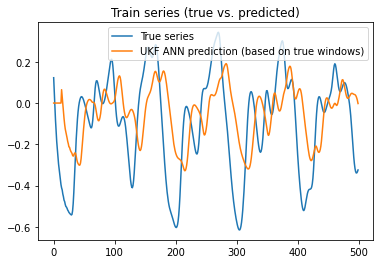

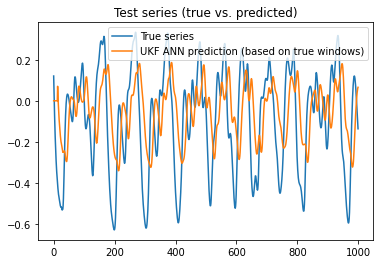

2020-07-17 17:25:49,594 [INFO] Training complete. time_to_train = 140.79 sec, 2.35 min
2020-07-17 17:25:49,594 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:49,597 [INFO] Evaluating and visualizing neural net predictions


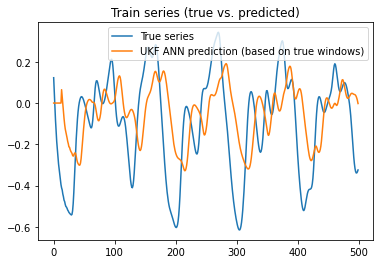

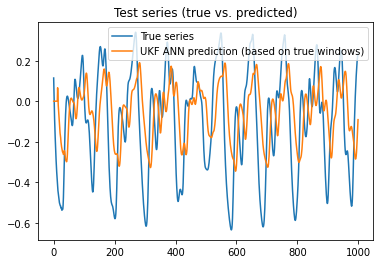

2020-07-17 17:25:50,927 [INFO] Training complete. time_to_train = 142.13 sec, 2.37 min
2020-07-17 17:25:50,928 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:50,930 [INFO] Evaluating and visualizing neural net predictions


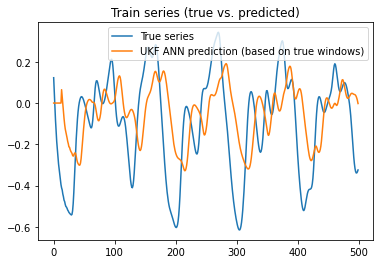

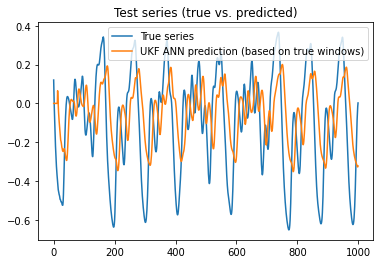

2020-07-17 17:25:52,266 [INFO] Training complete. time_to_train = 143.47 sec, 2.39 min
2020-07-17 17:25:52,267 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:52,271 [INFO] Evaluating and visualizing neural net predictions


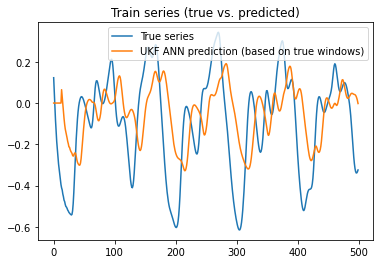

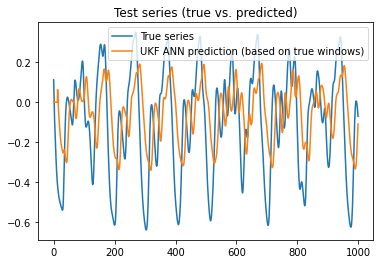

2020-07-17 17:25:53,612 [INFO] Training complete. time_to_train = 144.81 sec, 2.41 min
2020-07-17 17:25:53,613 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:53,614 [INFO] Evaluating and visualizing neural net predictions


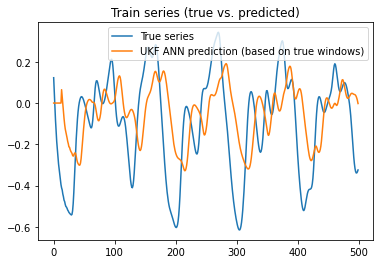

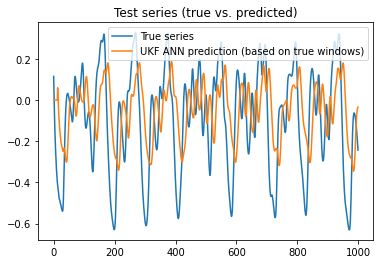

2020-07-17 17:25:54,958 [INFO] Training complete. time_to_train = 146.16 sec, 2.44 min
2020-07-17 17:25:54,958 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:54,960 [INFO] Evaluating and visualizing neural net predictions


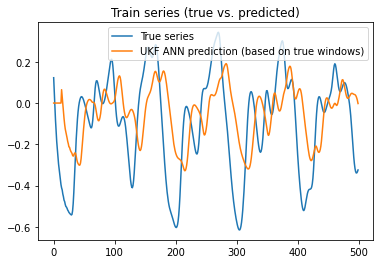

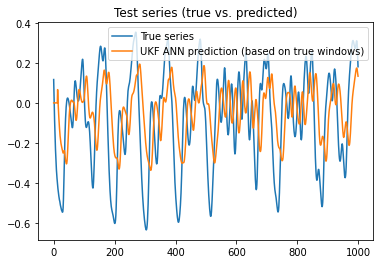

2020-07-17 17:25:56,327 [INFO] Training complete. time_to_train = 147.53 sec, 2.46 min
2020-07-17 17:25:56,329 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:56,330 [INFO] Evaluating and visualizing neural net predictions


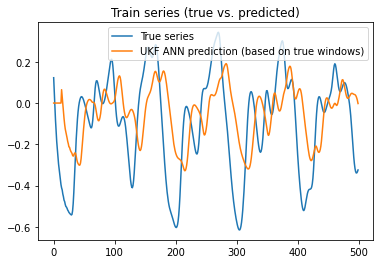

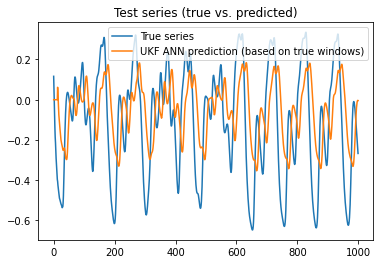

2020-07-17 17:25:57,669 [INFO] Training complete. time_to_train = 148.87 sec, 2.48 min
2020-07-17 17:25:57,670 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:57,671 [INFO] Evaluating and visualizing neural net predictions


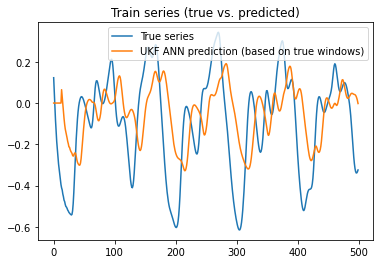

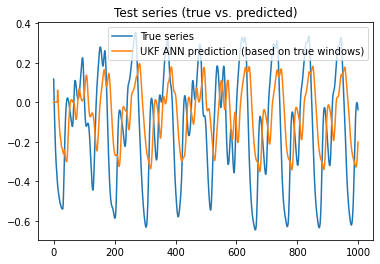

2020-07-17 17:25:59,009 [INFO] Training complete. time_to_train = 150.21 sec, 2.50 min
2020-07-17 17:25:59,010 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:25:59,011 [INFO] Evaluating and visualizing neural net predictions


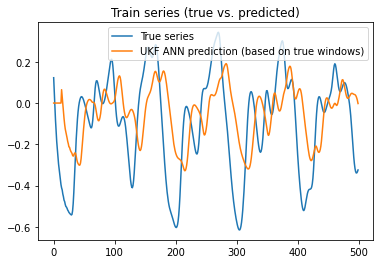

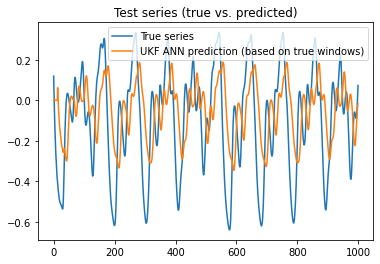

2020-07-17 17:26:00,357 [INFO] Training complete. time_to_train = 151.56 sec, 2.53 min
2020-07-17 17:26:00,357 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:00,358 [INFO] Evaluating and visualizing neural net predictions


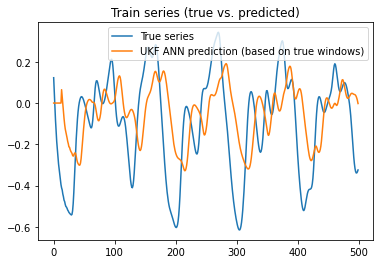

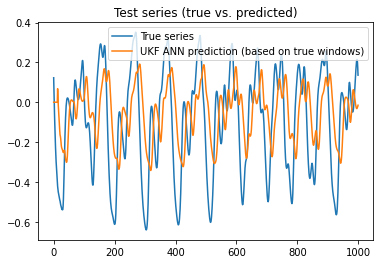

2020-07-17 17:26:01,705 [INFO] Training complete. time_to_train = 152.90 sec, 2.55 min
2020-07-17 17:26:01,706 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:01,709 [INFO] Evaluating and visualizing neural net predictions


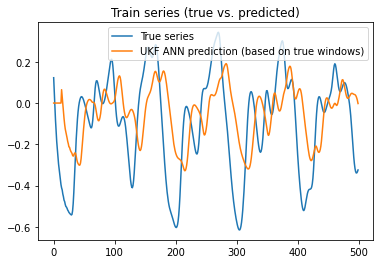

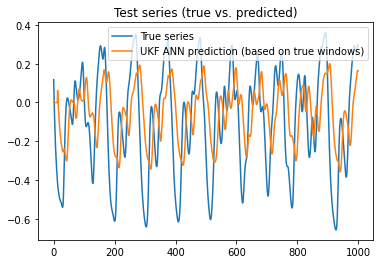

2020-07-17 17:26:03,050 [INFO] Training complete. time_to_train = 154.25 sec, 2.57 min
2020-07-17 17:26:03,051 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:03,053 [INFO] Evaluating and visualizing neural net predictions


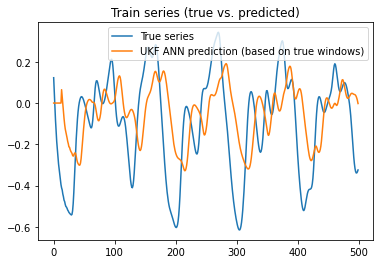

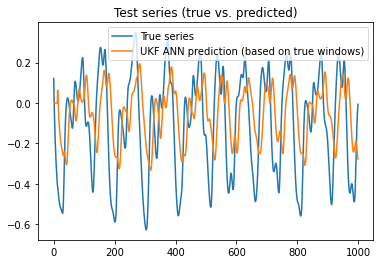

2020-07-17 17:26:04,741 [INFO] Training complete. time_to_train = 155.94 sec, 2.60 min
2020-07-17 17:26:04,742 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:04,743 [INFO] Evaluating and visualizing neural net predictions


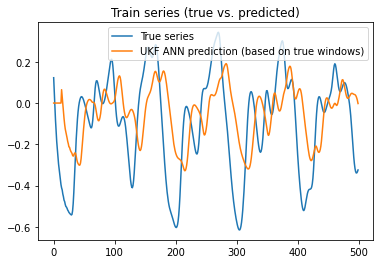

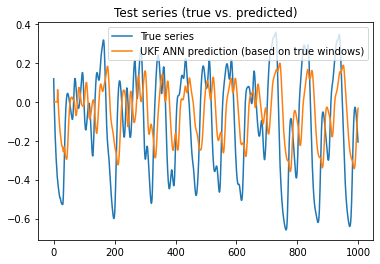

2020-07-17 17:26:06,085 [INFO] Training complete. time_to_train = 157.28 sec, 2.62 min
2020-07-17 17:26:06,086 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:06,090 [INFO] Evaluating and visualizing neural net predictions


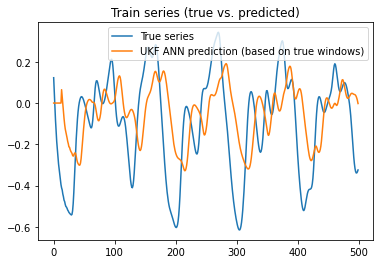

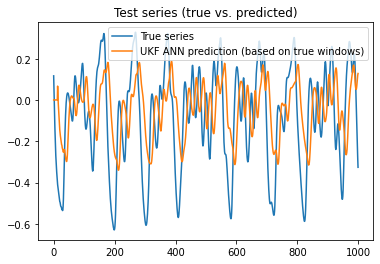

2020-07-17 17:26:07,442 [INFO] Training complete. time_to_train = 158.64 sec, 2.64 min
2020-07-17 17:26:07,443 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:07,444 [INFO] Evaluating and visualizing neural net predictions


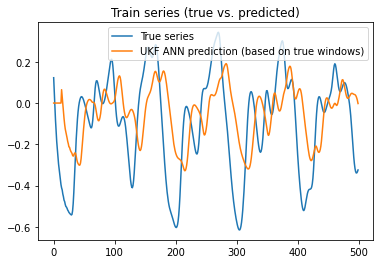

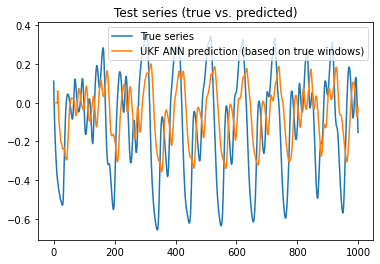

2020-07-17 17:26:08,784 [INFO] Training complete. time_to_train = 159.98 sec, 2.67 min
2020-07-17 17:26:08,785 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:08,785 [INFO] Evaluating and visualizing neural net predictions


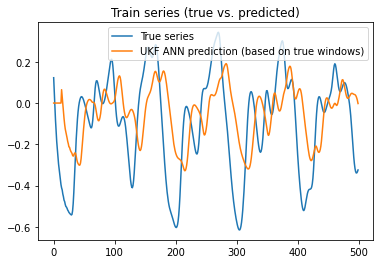

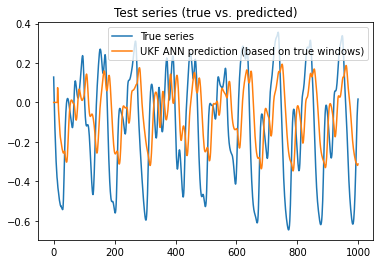

2020-07-17 17:26:10,123 [INFO] Training complete. time_to_train = 161.32 sec, 2.69 min
2020-07-17 17:26:10,124 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:10,126 [INFO] Evaluating and visualizing neural net predictions


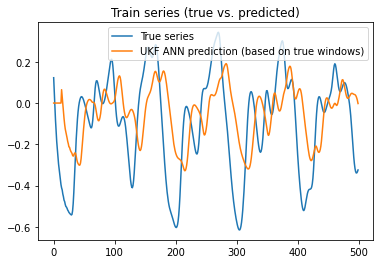

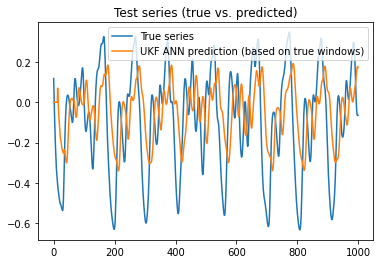

2020-07-17 17:26:11,455 [INFO] Training complete. time_to_train = 162.65 sec, 2.71 min
2020-07-17 17:26:11,456 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:11,459 [INFO] Evaluating and visualizing neural net predictions


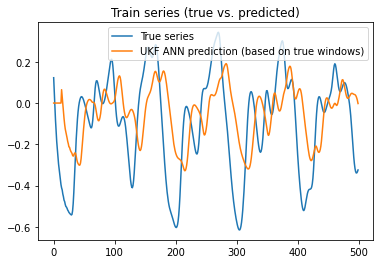

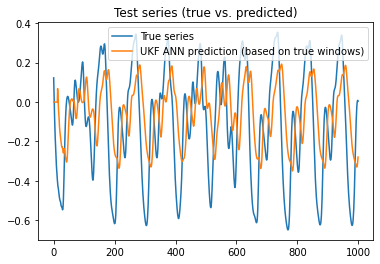

2020-07-17 17:26:12,783 [INFO] Training complete. time_to_train = 163.98 sec, 2.73 min
2020-07-17 17:26:12,784 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:12,786 [INFO] Evaluating and visualizing neural net predictions


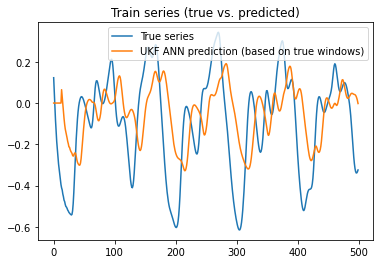

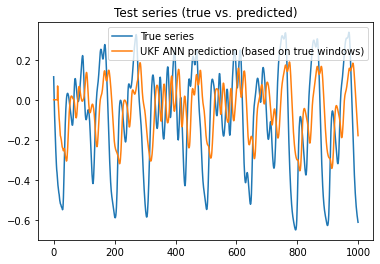

2020-07-17 17:26:14,143 [INFO] Training complete. time_to_train = 165.34 sec, 2.76 min
2020-07-17 17:26:14,144 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:14,144 [INFO] Evaluating and visualizing neural net predictions


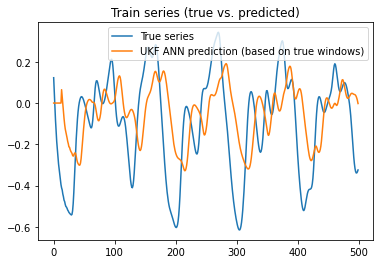

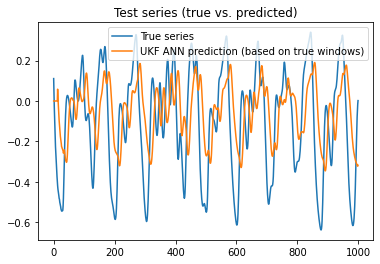

2020-07-17 17:26:15,484 [INFO] Training complete. time_to_train = 166.68 sec, 2.78 min
2020-07-17 17:26:15,485 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:15,486 [INFO] Evaluating and visualizing neural net predictions


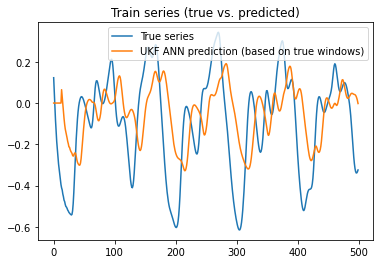

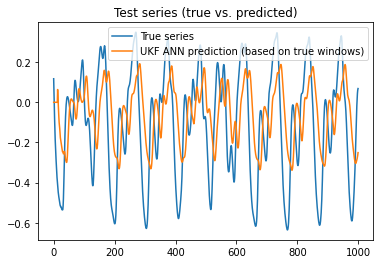

2020-07-17 17:26:16,834 [INFO] Training complete. time_to_train = 168.03 sec, 2.80 min
2020-07-17 17:26:16,835 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:16,837 [INFO] Evaluating and visualizing neural net predictions


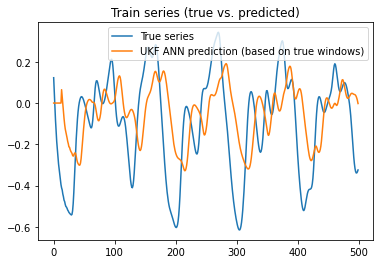

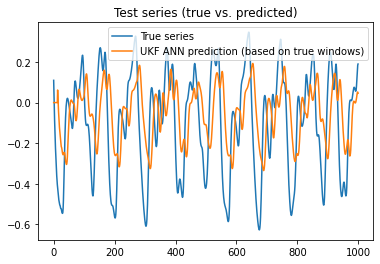

2020-07-17 17:26:18,184 [INFO] Training complete. time_to_train = 169.38 sec, 2.82 min
2020-07-17 17:26:18,185 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:18,186 [INFO] Evaluating and visualizing neural net predictions


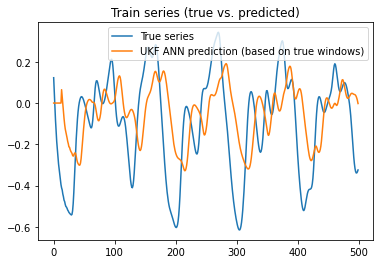

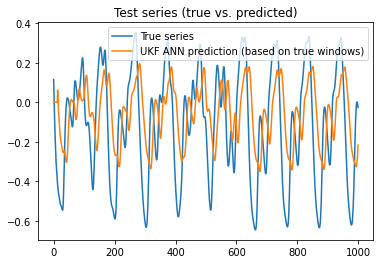

2020-07-17 17:26:19,526 [INFO] Training complete. time_to_train = 170.72 sec, 2.85 min
2020-07-17 17:26:19,527 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:19,528 [INFO] Evaluating and visualizing neural net predictions


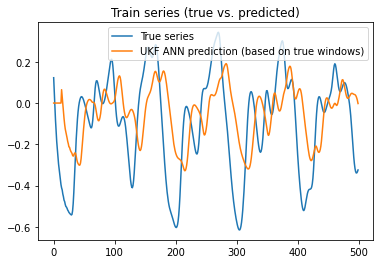

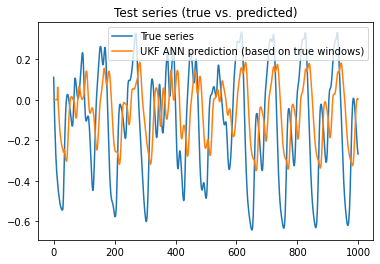

2020-07-17 17:26:20,885 [INFO] Training complete. time_to_train = 172.08 sec, 2.87 min
2020-07-17 17:26:20,888 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:20,889 [INFO] Evaluating and visualizing neural net predictions


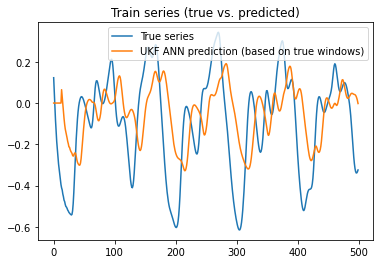

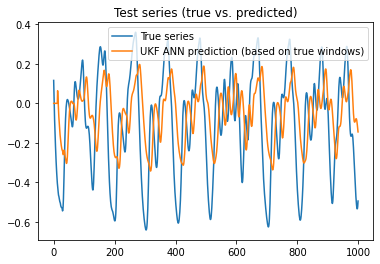

2020-07-17 17:26:22,229 [INFO] Training complete. time_to_train = 173.43 sec, 2.89 min
2020-07-17 17:26:22,230 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:22,233 [INFO] Evaluating and visualizing neural net predictions


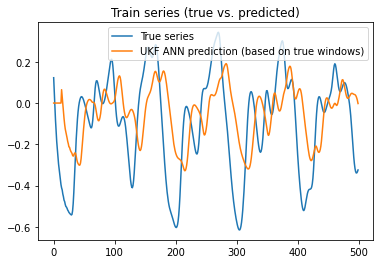

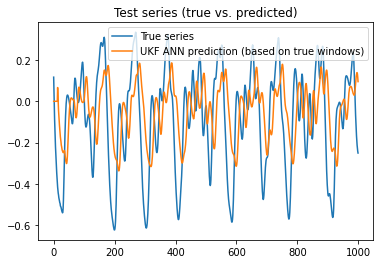

2020-07-17 17:26:23,566 [INFO] Training complete. time_to_train = 174.77 sec, 2.91 min
2020-07-17 17:26:23,567 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:23,570 [INFO] Evaluating and visualizing neural net predictions


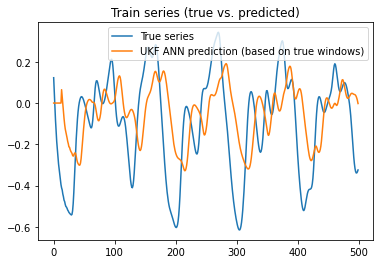

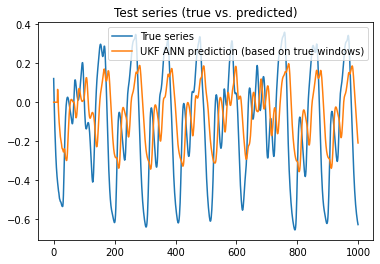

2020-07-17 17:26:24,904 [INFO] Training complete. time_to_train = 176.10 sec, 2.94 min
2020-07-17 17:26:24,907 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:24,910 [INFO] Evaluating and visualizing neural net predictions


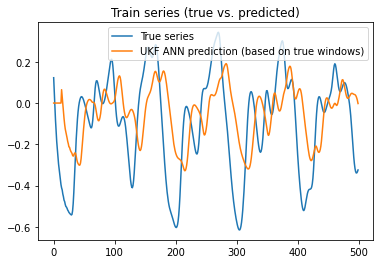

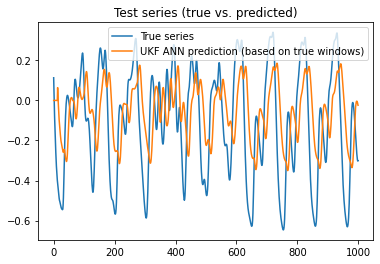

2020-07-17 17:26:26,271 [INFO] Training complete. time_to_train = 177.47 sec, 2.96 min
2020-07-17 17:26:26,272 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:26,273 [INFO] Evaluating and visualizing neural net predictions


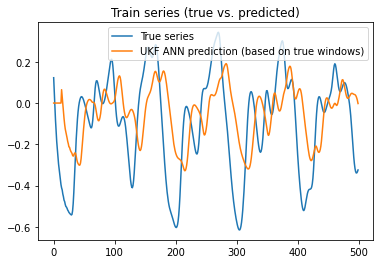

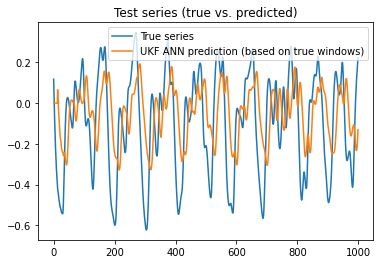

2020-07-17 17:26:27,620 [INFO] Training complete. time_to_train = 178.82 sec, 2.98 min
2020-07-17 17:26:27,621 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:27,622 [INFO] Evaluating and visualizing neural net predictions


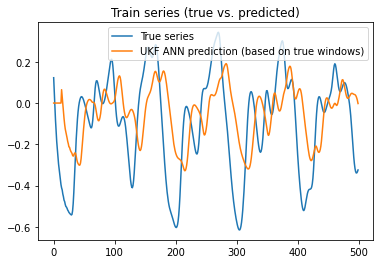

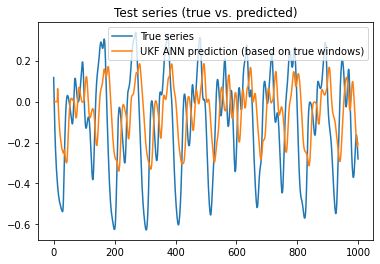

2020-07-17 17:26:28,962 [INFO] Training complete. time_to_train = 180.16 sec, 3.00 min
2020-07-17 17:26:28,962 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:28,964 [INFO] Evaluating and visualizing neural net predictions


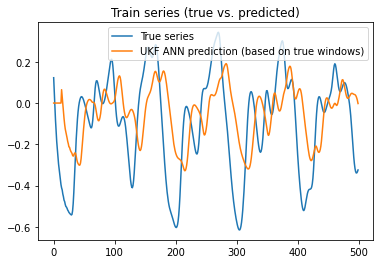

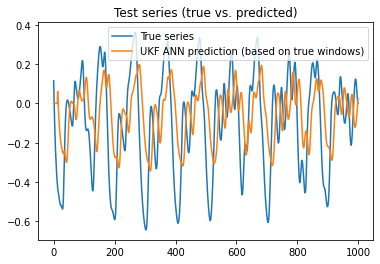

2020-07-17 17:26:30,431 [INFO] Training complete. time_to_train = 181.63 sec, 3.03 min
2020-07-17 17:26:30,432 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:30,433 [INFO] Evaluating and visualizing neural net predictions


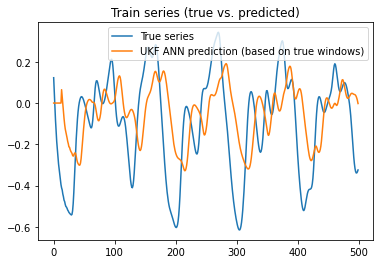

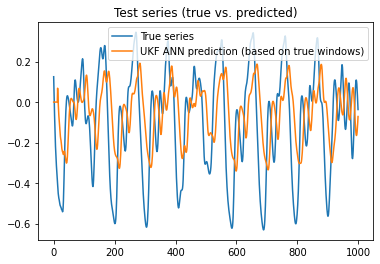

2020-07-17 17:26:31,984 [INFO] Training complete. time_to_train = 183.18 sec, 3.05 min
2020-07-17 17:26:31,985 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:31,989 [INFO] Evaluating and visualizing neural net predictions


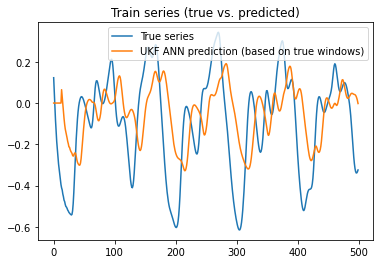

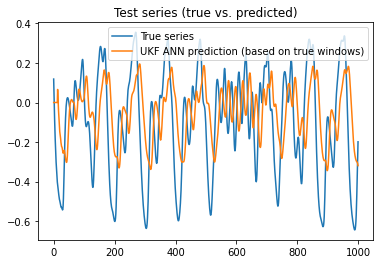

2020-07-17 17:26:33,498 [INFO] Training complete. time_to_train = 184.70 sec, 3.08 min
2020-07-17 17:26:33,498 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:33,500 [INFO] Evaluating and visualizing neural net predictions


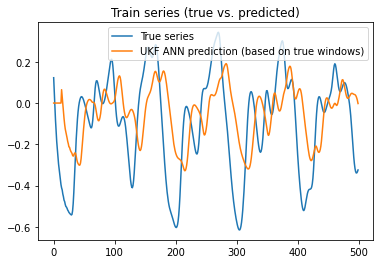

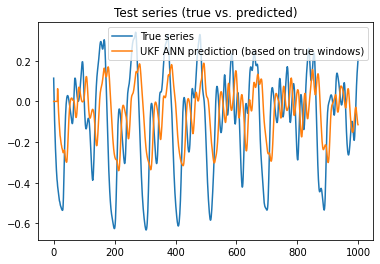

2020-07-17 17:26:35,022 [INFO] Training complete. time_to_train = 186.22 sec, 3.10 min
2020-07-17 17:26:35,023 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:35,023 [INFO] Evaluating and visualizing neural net predictions


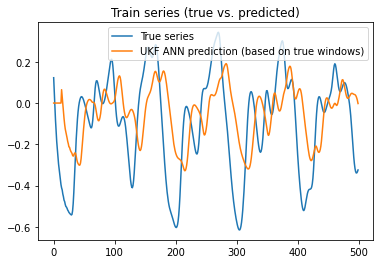

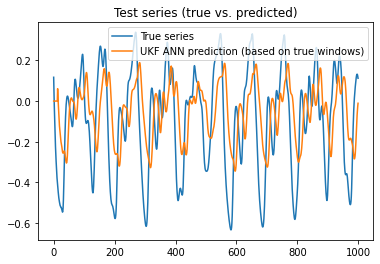

2020-07-17 17:26:36,544 [INFO] Training complete. time_to_train = 187.74 sec, 3.13 min
2020-07-17 17:26:36,544 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:36,545 [INFO] Evaluating and visualizing neural net predictions


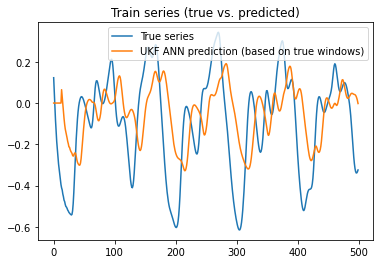

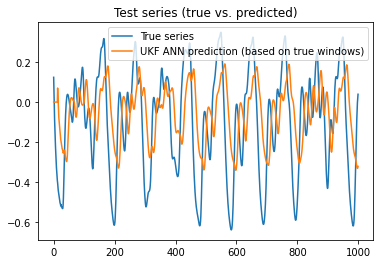

2020-07-17 17:26:38,063 [INFO] Training complete. time_to_train = 189.26 sec, 3.15 min
2020-07-17 17:26:38,064 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:38,065 [INFO] Evaluating and visualizing neural net predictions


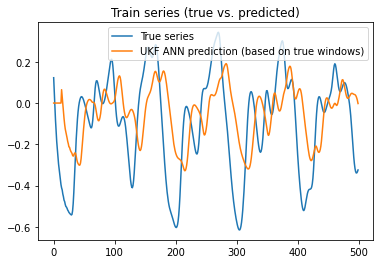

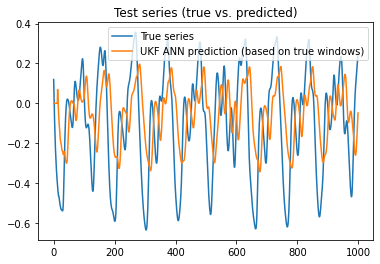

2020-07-17 17:26:39,583 [INFO] Training complete. time_to_train = 190.78 sec, 3.18 min
2020-07-17 17:26:39,583 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:39,584 [INFO] Evaluating and visualizing neural net predictions


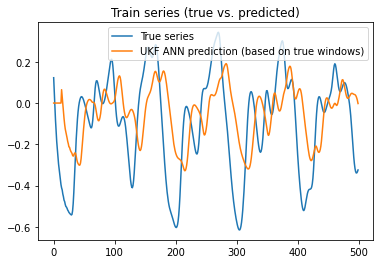

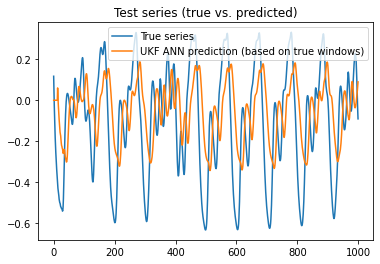

2020-07-17 17:26:40,969 [INFO] Training complete. time_to_train = 192.17 sec, 3.20 min
2020-07-17 17:26:40,972 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:40,974 [INFO] Evaluating and visualizing neural net predictions


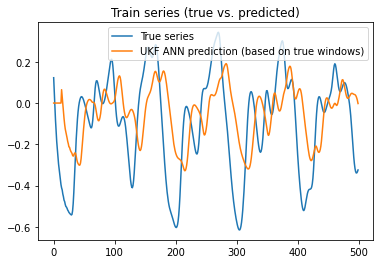

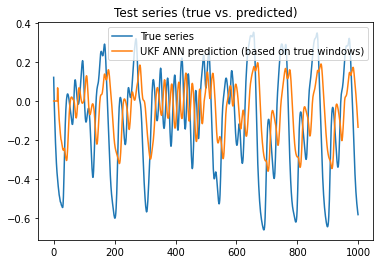

2020-07-17 17:26:42,299 [INFO] Training complete. time_to_train = 193.50 sec, 3.22 min
2020-07-17 17:26:42,300 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:42,302 [INFO] Evaluating and visualizing neural net predictions


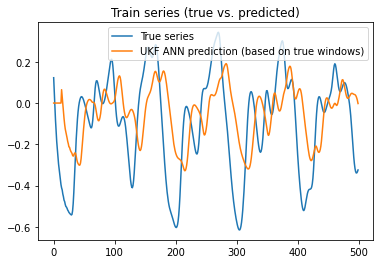

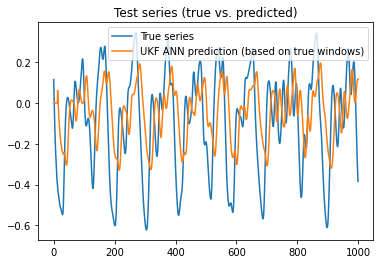

2020-07-17 17:26:43,638 [INFO] Training complete. time_to_train = 194.84 sec, 3.25 min
2020-07-17 17:26:43,638 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:43,639 [INFO] Evaluating and visualizing neural net predictions


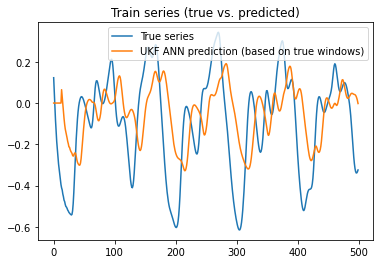

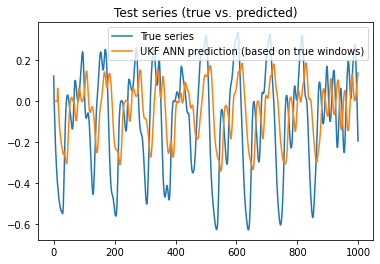

2020-07-17 17:26:44,996 [INFO] Training complete. time_to_train = 196.19 sec, 3.27 min
2020-07-17 17:26:44,996 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:44,999 [INFO] Evaluating and visualizing neural net predictions


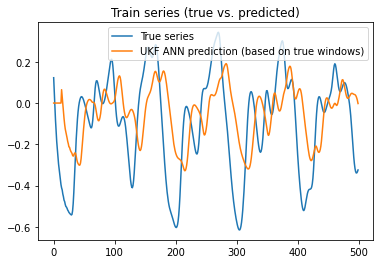

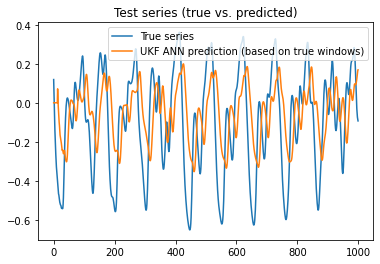

2020-07-17 17:26:46,356 [INFO] Training complete. time_to_train = 197.55 sec, 3.29 min
2020-07-17 17:26:46,357 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:46,359 [INFO] Evaluating and visualizing neural net predictions


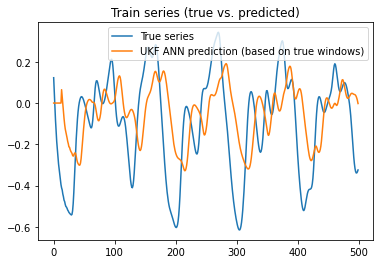

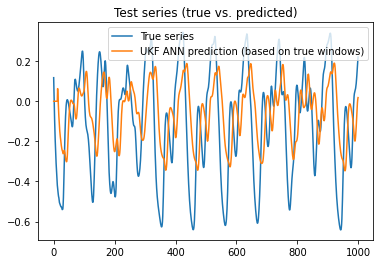

2020-07-17 17:26:47,754 [INFO] Training complete. time_to_train = 198.95 sec, 3.32 min
2020-07-17 17:26:47,755 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:47,759 [INFO] Evaluating and visualizing neural net predictions


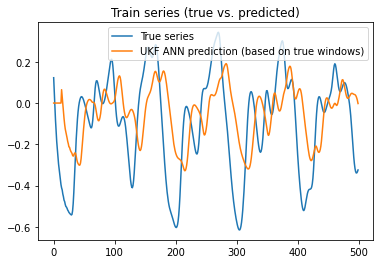

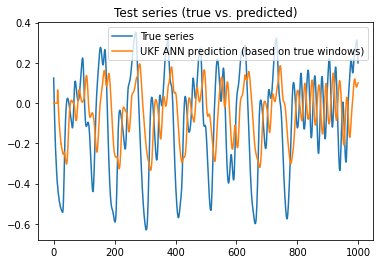

2020-07-17 17:26:49,101 [INFO] Training complete. time_to_train = 200.30 sec, 3.34 min
2020-07-17 17:26:49,102 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:49,103 [INFO] Evaluating and visualizing neural net predictions


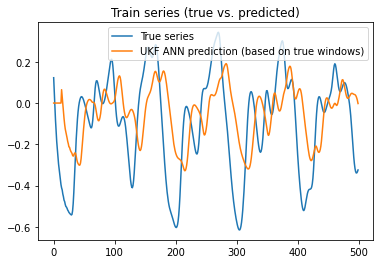

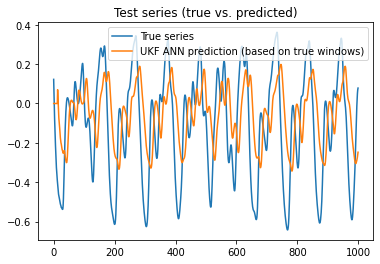

2020-07-17 17:26:50,473 [INFO] Training complete. time_to_train = 201.67 sec, 3.36 min
2020-07-17 17:26:50,474 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:50,476 [INFO] Evaluating and visualizing neural net predictions


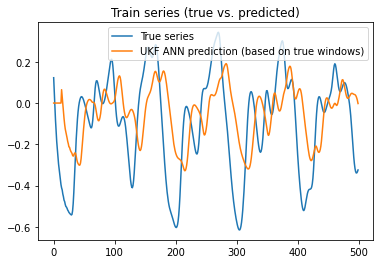

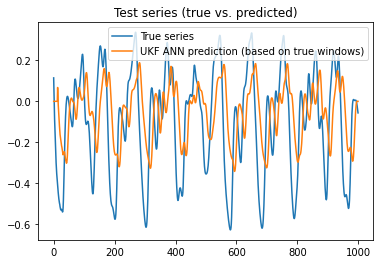

2020-07-17 17:26:51,824 [INFO] Training complete. time_to_train = 203.02 sec, 3.38 min
2020-07-17 17:26:51,825 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:51,825 [INFO] Evaluating and visualizing neural net predictions


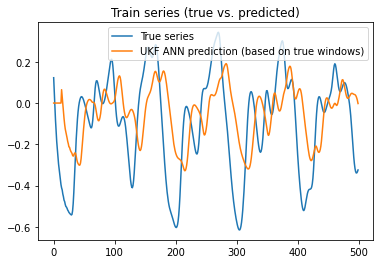

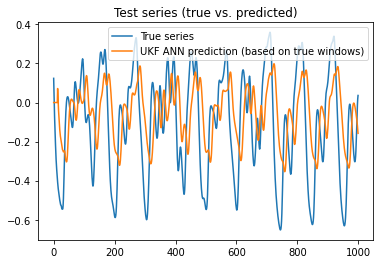

2020-07-17 17:26:53,175 [INFO] Training complete. time_to_train = 204.37 sec, 3.41 min
2020-07-17 17:26:53,175 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:53,177 [INFO] Evaluating and visualizing neural net predictions


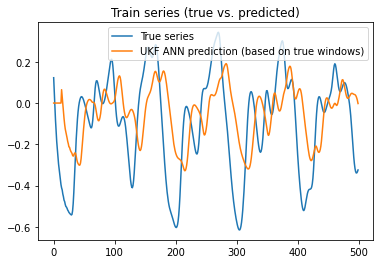

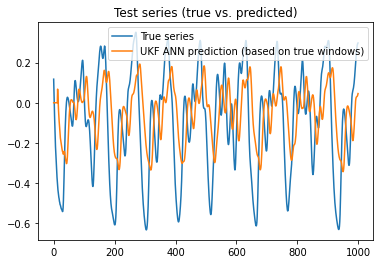

2020-07-17 17:26:54,524 [INFO] Training complete. time_to_train = 205.72 sec, 3.43 min
2020-07-17 17:26:54,524 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:54,525 [INFO] Evaluating and visualizing neural net predictions


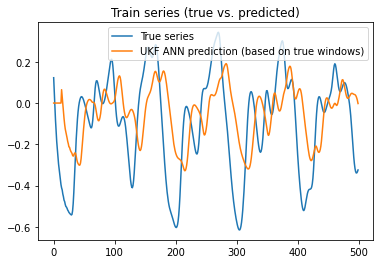

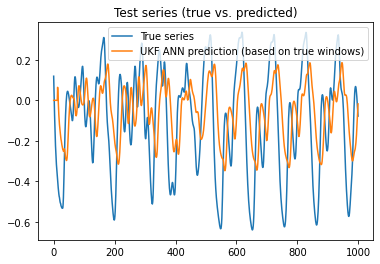

2020-07-17 17:26:55,854 [INFO] Training complete. time_to_train = 207.05 sec, 3.45 min
2020-07-17 17:26:55,855 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:55,859 [INFO] Evaluating and visualizing neural net predictions


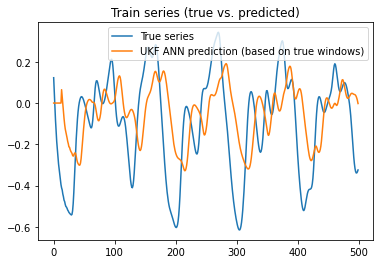

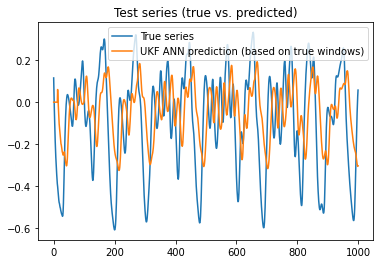

2020-07-17 17:26:57,642 [INFO] Training complete. time_to_train = 208.84 sec, 3.48 min
2020-07-17 17:26:57,644 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:57,647 [INFO] Evaluating and visualizing neural net predictions


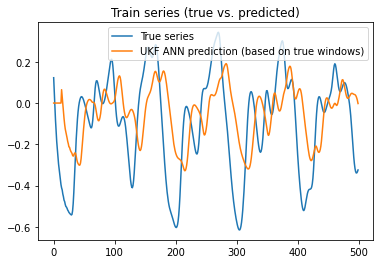

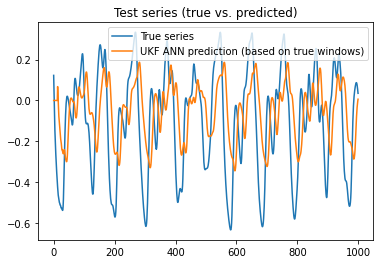

2020-07-17 17:26:58,977 [INFO] Training complete. time_to_train = 210.18 sec, 3.50 min
2020-07-17 17:26:58,978 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:26:58,978 [INFO] Evaluating and visualizing neural net predictions


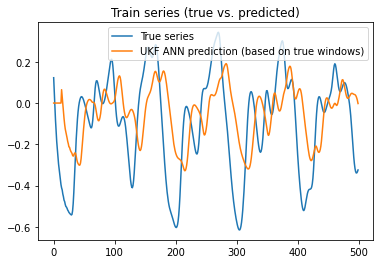

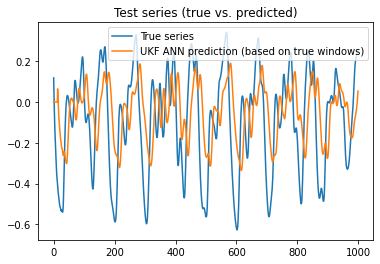

2020-07-17 17:27:00,334 [INFO] Training complete. time_to_train = 211.53 sec, 3.53 min
2020-07-17 17:27:00,335 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:00,336 [INFO] Evaluating and visualizing neural net predictions


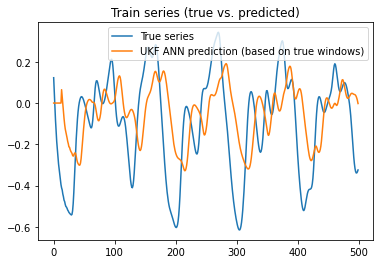

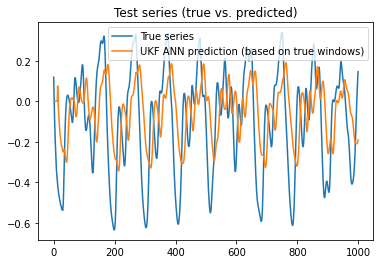

2020-07-17 17:27:01,662 [INFO] Training complete. time_to_train = 212.86 sec, 3.55 min
2020-07-17 17:27:01,664 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:01,665 [INFO] Evaluating and visualizing neural net predictions


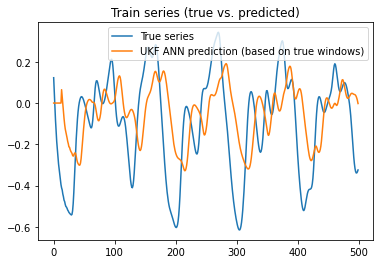

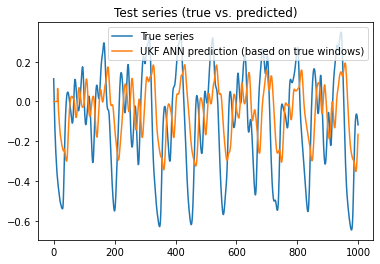

2020-07-17 17:27:03,000 [INFO] Training complete. time_to_train = 214.20 sec, 3.57 min
2020-07-17 17:27:03,001 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:03,001 [INFO] Evaluating and visualizing neural net predictions


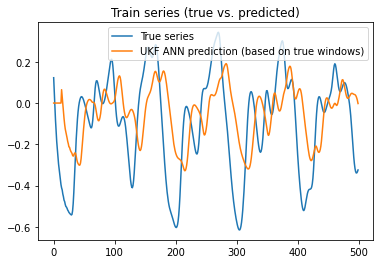

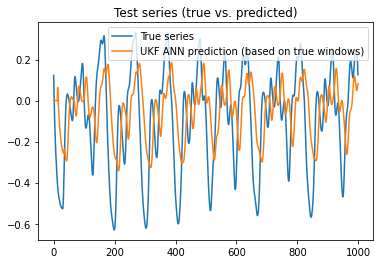

2020-07-17 17:27:04,344 [INFO] Training complete. time_to_train = 215.54 sec, 3.59 min
2020-07-17 17:27:04,346 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:04,347 [INFO] Evaluating and visualizing neural net predictions


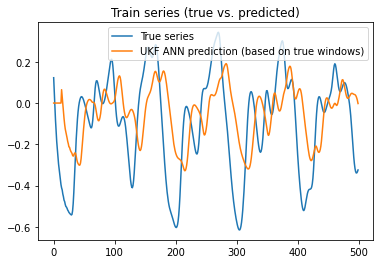

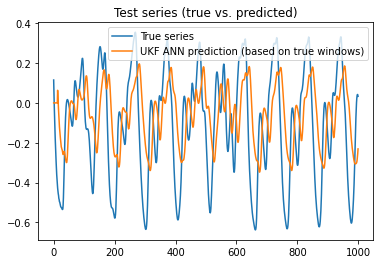

2020-07-17 17:27:05,681 [INFO] Training complete. time_to_train = 216.88 sec, 3.61 min
2020-07-17 17:27:05,682 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:05,683 [INFO] Evaluating and visualizing neural net predictions


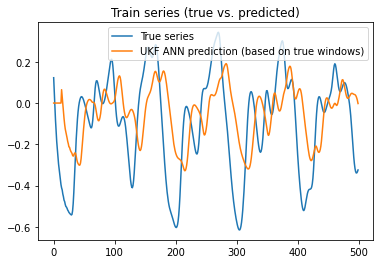

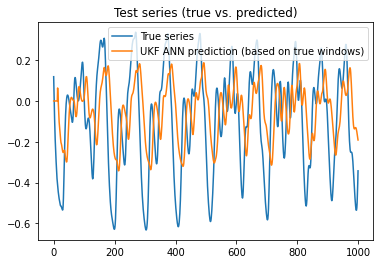

2020-07-17 17:27:07,024 [INFO] Training complete. time_to_train = 218.22 sec, 3.64 min
2020-07-17 17:27:07,025 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:07,026 [INFO] Evaluating and visualizing neural net predictions


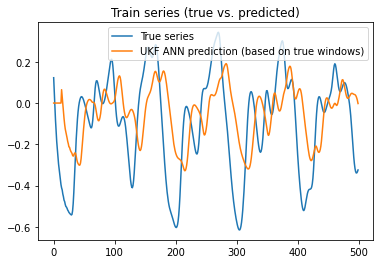

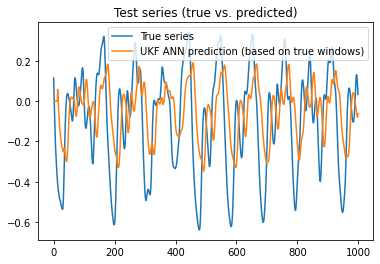

2020-07-17 17:27:08,386 [INFO] Training complete. time_to_train = 219.58 sec, 3.66 min
2020-07-17 17:27:08,387 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:08,388 [INFO] Evaluating and visualizing neural net predictions


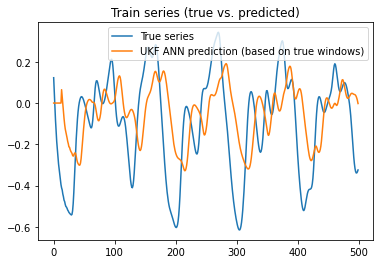

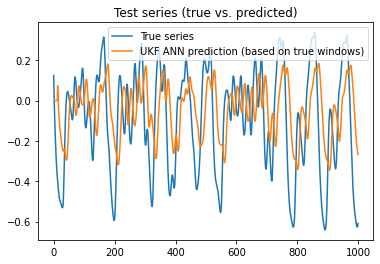

2020-07-17 17:27:09,713 [INFO] Training complete. time_to_train = 220.91 sec, 3.68 min
2020-07-17 17:27:09,714 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:09,715 [INFO] Evaluating and visualizing neural net predictions


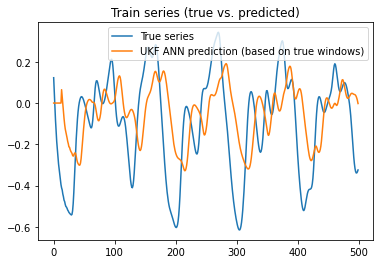

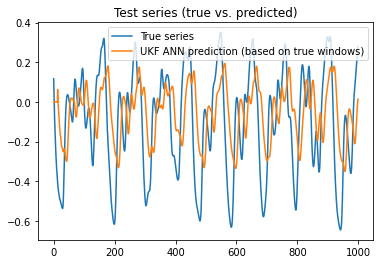

2020-07-17 17:27:11,043 [INFO] Training complete. time_to_train = 222.24 sec, 3.70 min
2020-07-17 17:27:11,044 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:11,046 [INFO] Evaluating and visualizing neural net predictions


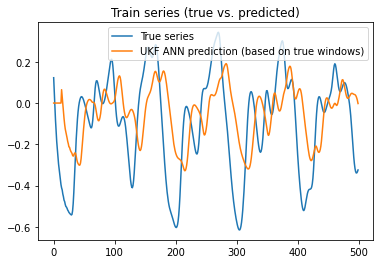

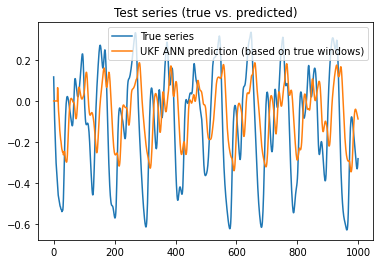

2020-07-17 17:27:12,394 [INFO] Training complete. time_to_train = 223.59 sec, 3.73 min
2020-07-17 17:27:12,395 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:12,397 [INFO] Evaluating and visualizing neural net predictions


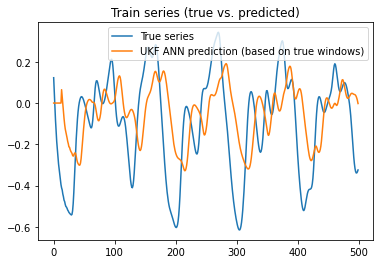

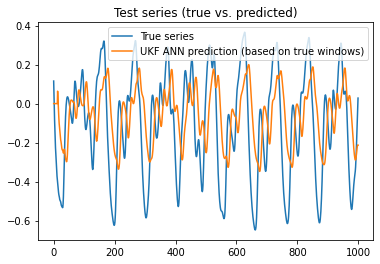

2020-07-17 17:27:13,750 [INFO] Training complete. time_to_train = 224.95 sec, 3.75 min
2020-07-17 17:27:13,751 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:13,753 [INFO] Evaluating and visualizing neural net predictions


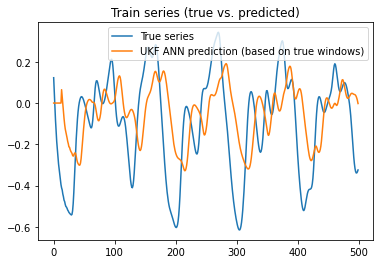

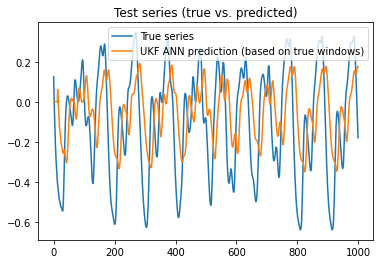

2020-07-17 17:27:15,130 [INFO] Training complete. time_to_train = 226.33 sec, 3.77 min
2020-07-17 17:27:15,133 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:15,133 [INFO] Evaluating and visualizing neural net predictions


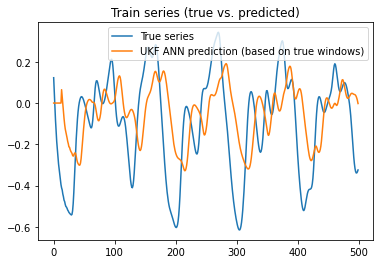

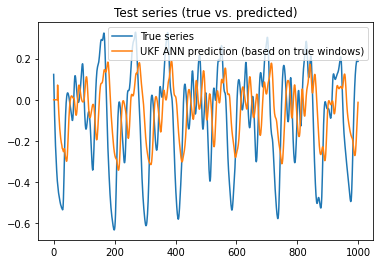

2020-07-17 17:27:16,462 [INFO] Training complete. time_to_train = 227.66 sec, 3.79 min
2020-07-17 17:27:16,463 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:16,463 [INFO] Evaluating and visualizing neural net predictions


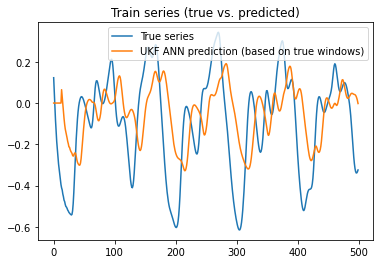

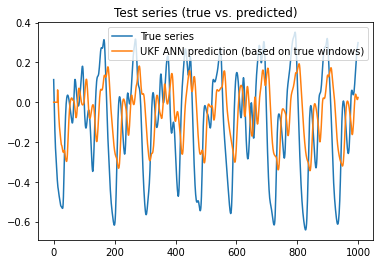

2020-07-17 17:27:17,787 [INFO] Training complete. time_to_train = 228.99 sec, 3.82 min
2020-07-17 17:27:17,789 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:17,790 [INFO] Evaluating and visualizing neural net predictions


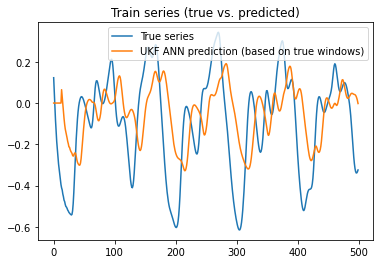

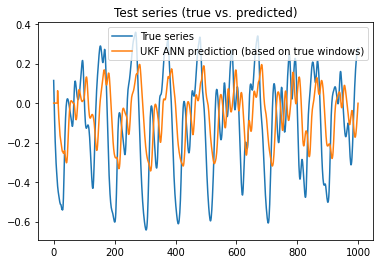

2020-07-17 17:27:19,143 [INFO] Training complete. time_to_train = 230.34 sec, 3.84 min
2020-07-17 17:27:19,145 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:19,146 [INFO] Evaluating and visualizing neural net predictions


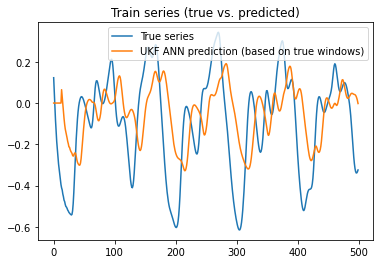

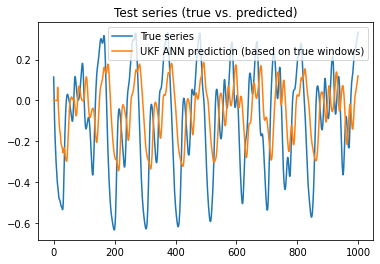

2020-07-17 17:27:20,480 [INFO] Training complete. time_to_train = 231.68 sec, 3.86 min
2020-07-17 17:27:20,481 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:20,485 [INFO] Evaluating and visualizing neural net predictions


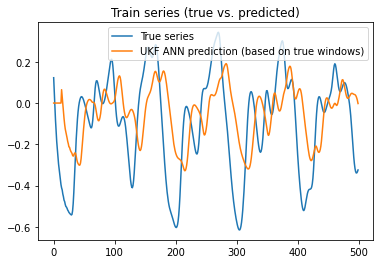

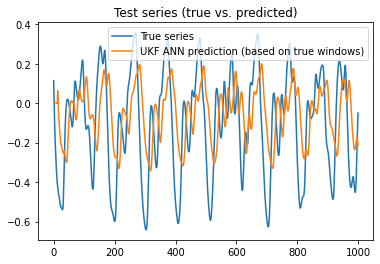

2020-07-17 17:27:21,821 [INFO] Training complete. time_to_train = 233.02 sec, 3.88 min
2020-07-17 17:27:21,822 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:21,822 [INFO] Evaluating and visualizing neural net predictions


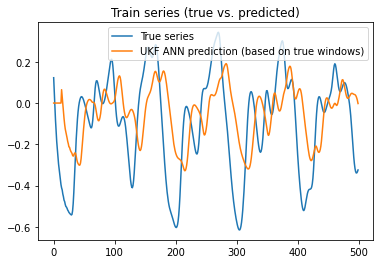

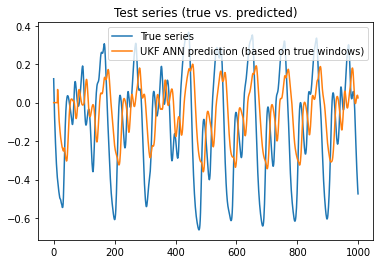

2020-07-17 17:27:23,176 [INFO] Training complete. time_to_train = 234.37 sec, 3.91 min
2020-07-17 17:27:23,178 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:23,179 [INFO] Evaluating and visualizing neural net predictions


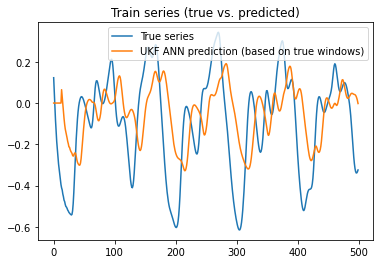

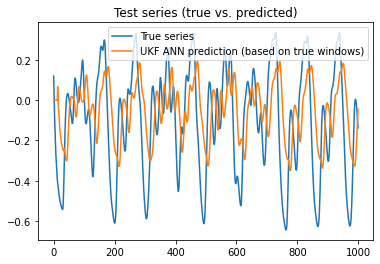

2020-07-17 17:27:24,519 [INFO] Training complete. time_to_train = 235.72 sec, 3.93 min
2020-07-17 17:27:24,521 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:24,522 [INFO] Evaluating and visualizing neural net predictions


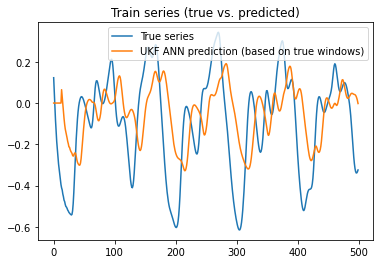

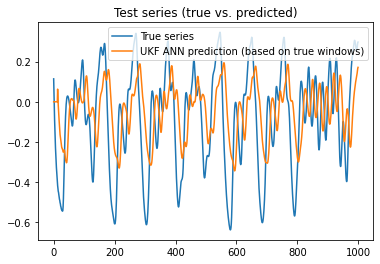

2020-07-17 17:27:25,849 [INFO] Training complete. time_to_train = 237.05 sec, 3.95 min
2020-07-17 17:27:25,850 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:25,851 [INFO] Evaluating and visualizing neural net predictions


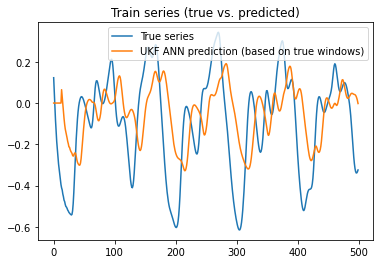

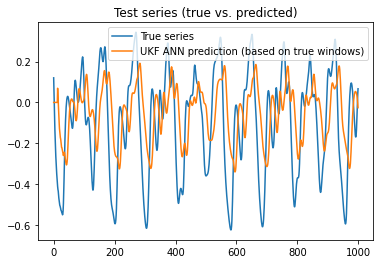

2020-07-17 17:27:27,181 [INFO] Training complete. time_to_train = 238.38 sec, 3.97 min
2020-07-17 17:27:27,182 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:27,184 [INFO] Evaluating and visualizing neural net predictions


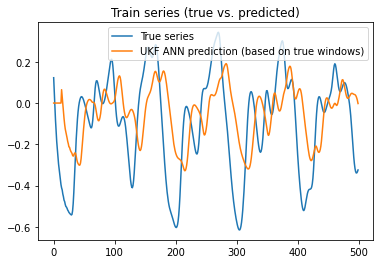

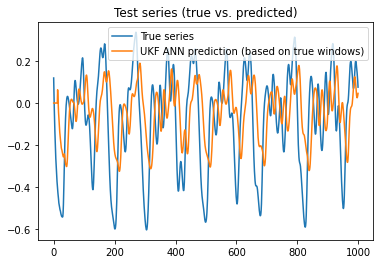

2020-07-17 17:27:28,509 [INFO] Training complete. time_to_train = 239.71 sec, 4.00 min
2020-07-17 17:27:28,510 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:28,510 [INFO] Evaluating and visualizing neural net predictions


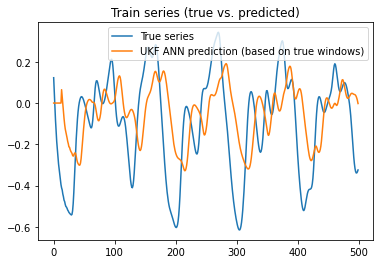

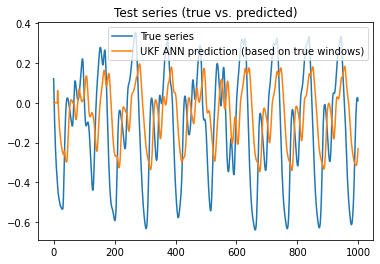

2020-07-17 17:27:29,871 [INFO] Training complete. time_to_train = 241.07 sec, 4.02 min
2020-07-17 17:27:29,872 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:29,875 [INFO] Evaluating and visualizing neural net predictions


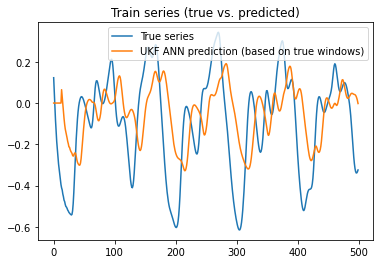

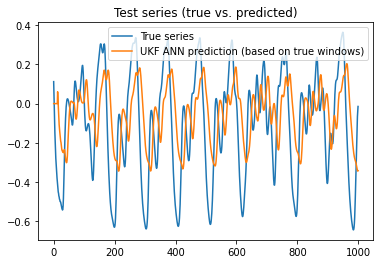

2020-07-17 17:27:31,207 [INFO] Training complete. time_to_train = 242.41 sec, 4.04 min
2020-07-17 17:27:31,208 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:31,212 [INFO] Evaluating and visualizing neural net predictions


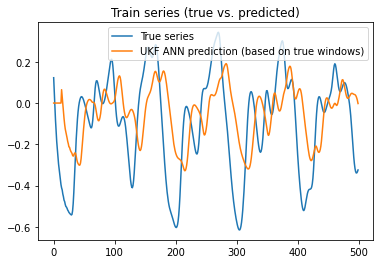

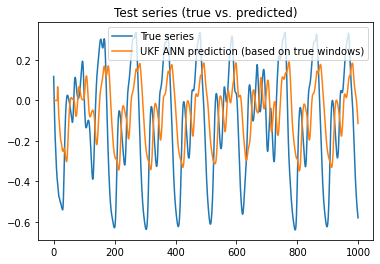

2020-07-17 17:27:32,556 [INFO] Training complete. time_to_train = 243.75 sec, 4.06 min
2020-07-17 17:27:32,556 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:32,557 [INFO] Evaluating and visualizing neural net predictions


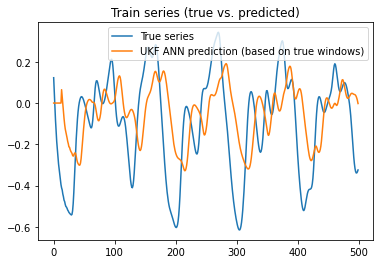

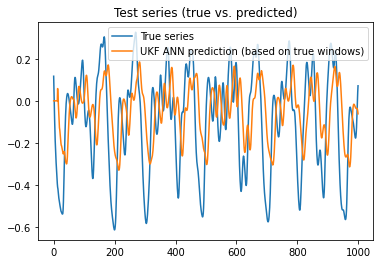

2020-07-17 17:27:33,895 [INFO] Training complete. time_to_train = 245.09 sec, 4.08 min
2020-07-17 17:27:33,895 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:33,897 [INFO] Evaluating and visualizing neural net predictions


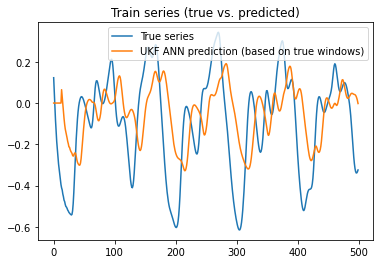

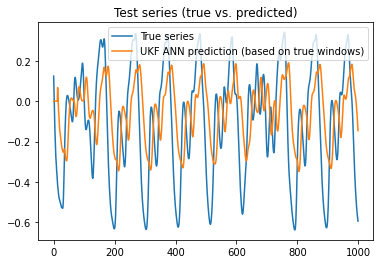

2020-07-17 17:27:35,238 [INFO] Training complete. time_to_train = 246.44 sec, 4.11 min
2020-07-17 17:27:35,239 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:35,242 [INFO] Evaluating and visualizing neural net predictions


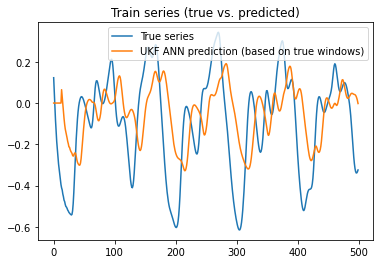

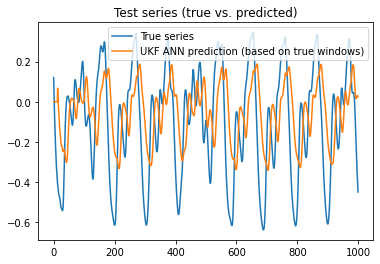

2020-07-17 17:27:36,571 [INFO] Training complete. time_to_train = 247.77 sec, 4.13 min
2020-07-17 17:27:36,571 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:36,575 [INFO] Evaluating and visualizing neural net predictions


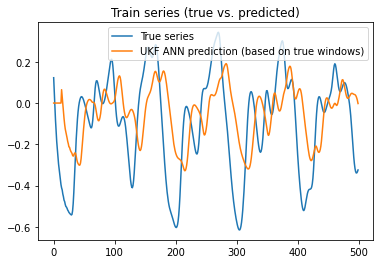

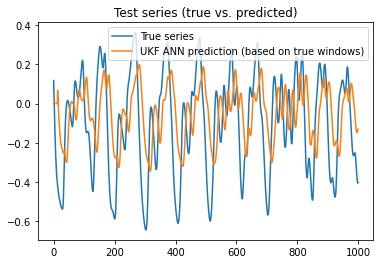

2020-07-17 17:27:37,903 [INFO] Training complete. time_to_train = 249.10 sec, 4.15 min
2020-07-17 17:27:37,903 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:37,904 [INFO] Evaluating and visualizing neural net predictions


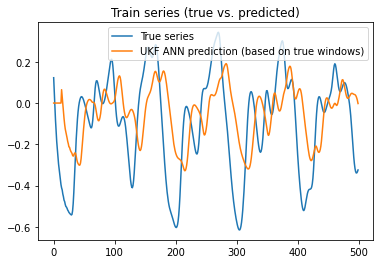

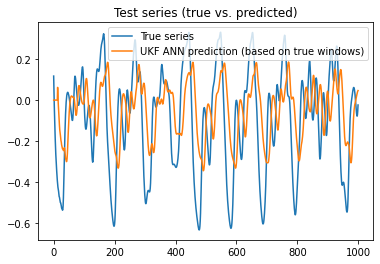

2020-07-17 17:27:39,265 [INFO] Training complete. time_to_train = 250.46 sec, 4.17 min
2020-07-17 17:27:39,266 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:39,270 [INFO] Evaluating and visualizing neural net predictions


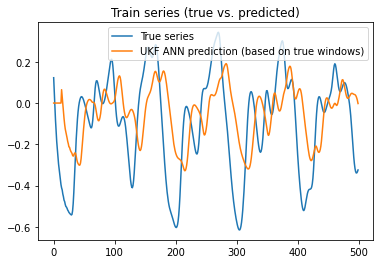

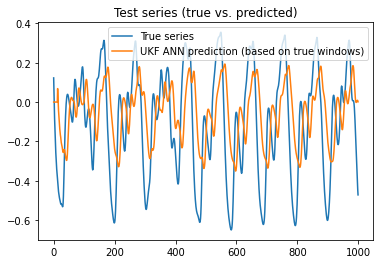

2020-07-17 17:27:40,613 [INFO] Training complete. time_to_train = 251.81 sec, 4.20 min
2020-07-17 17:27:40,614 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:40,615 [INFO] Evaluating and visualizing neural net predictions


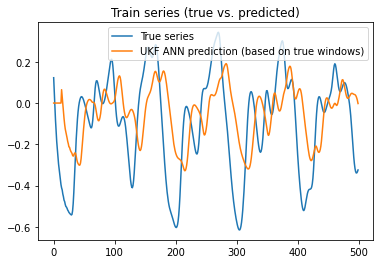

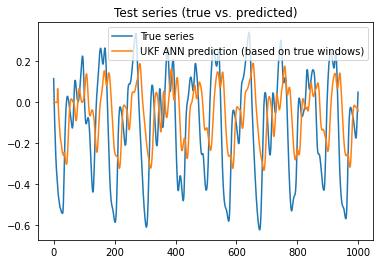

2020-07-17 17:27:41,963 [INFO] Training complete. time_to_train = 253.16 sec, 4.22 min
2020-07-17 17:27:41,965 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:41,966 [INFO] Evaluating and visualizing neural net predictions


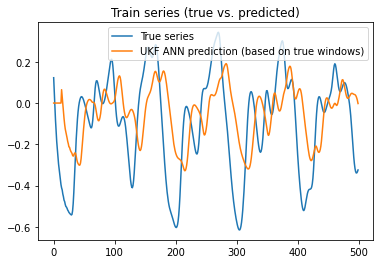

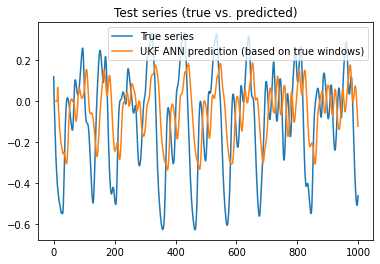

2020-07-17 17:27:43,294 [INFO] Training complete. time_to_train = 254.49 sec, 4.24 min
2020-07-17 17:27:43,294 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:43,295 [INFO] Evaluating and visualizing neural net predictions


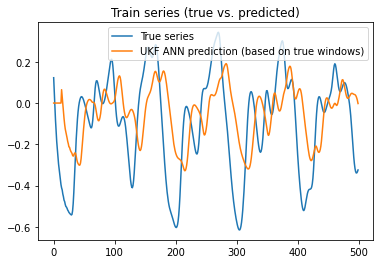

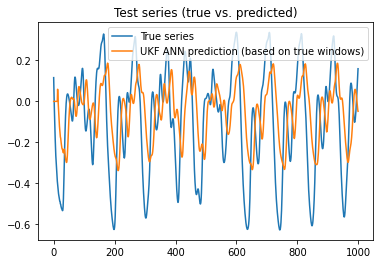

2020-07-17 17:27:44,630 [INFO] Training complete. time_to_train = 255.83 sec, 4.26 min
2020-07-17 17:27:44,631 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:44,632 [INFO] Evaluating and visualizing neural net predictions


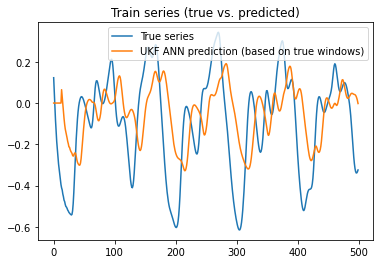

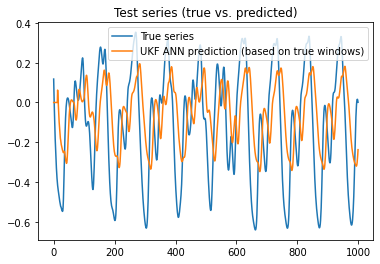

2020-07-17 17:27:45,990 [INFO] Training complete. time_to_train = 257.19 sec, 4.29 min
2020-07-17 17:27:45,991 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:45,993 [INFO] Evaluating and visualizing neural net predictions


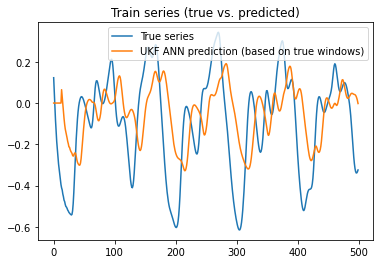

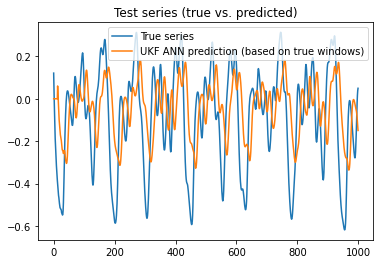

2020-07-17 17:27:47,341 [INFO] Training complete. time_to_train = 258.54 sec, 4.31 min
2020-07-17 17:27:47,343 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:47,344 [INFO] Evaluating and visualizing neural net predictions


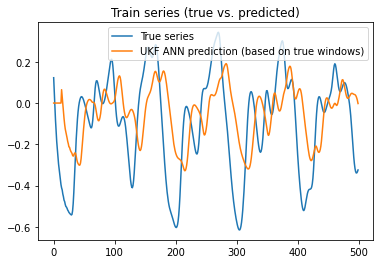

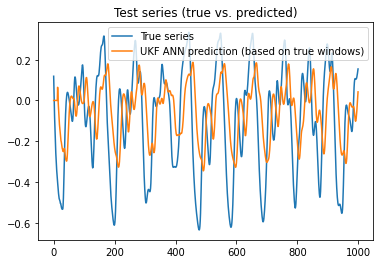

2020-07-17 17:27:48,755 [INFO] Training complete. time_to_train = 259.95 sec, 4.33 min
2020-07-17 17:27:48,756 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:48,760 [INFO] Evaluating and visualizing neural net predictions


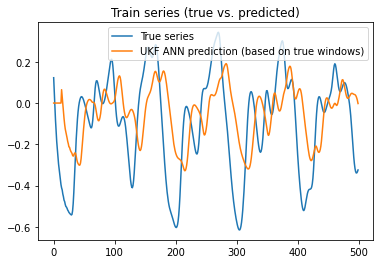

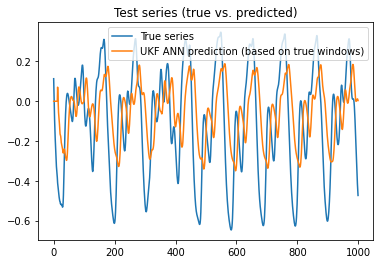

2020-07-17 17:27:50,125 [INFO] Training complete. time_to_train = 261.32 sec, 4.36 min
2020-07-17 17:27:50,125 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:50,126 [INFO] Evaluating and visualizing neural net predictions


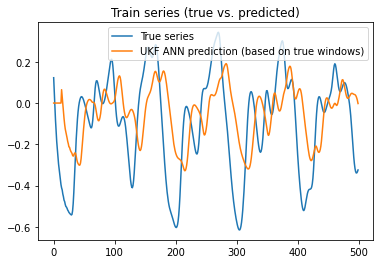

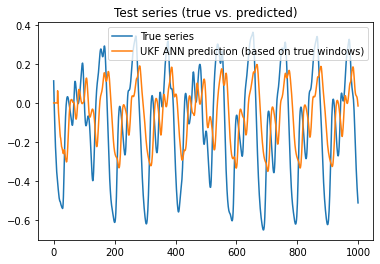

2020-07-17 17:27:51,452 [INFO] Training complete. time_to_train = 262.65 sec, 4.38 min
2020-07-17 17:27:51,453 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:51,454 [INFO] Evaluating and visualizing neural net predictions


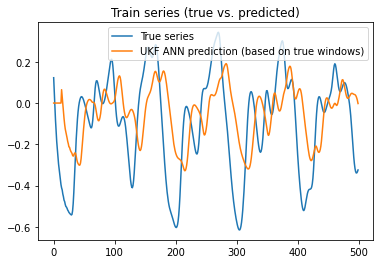

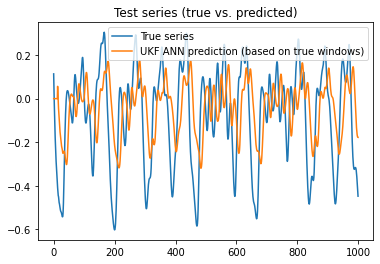

2020-07-17 17:27:52,797 [INFO] Training complete. time_to_train = 264.00 sec, 4.40 min
2020-07-17 17:27:52,798 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:52,799 [INFO] Evaluating and visualizing neural net predictions


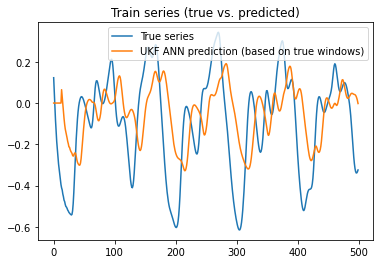

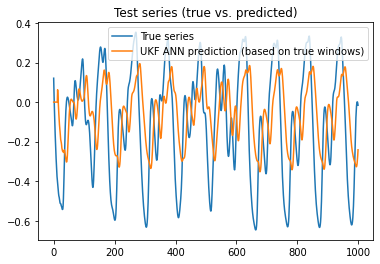

2020-07-17 17:27:54,159 [INFO] Training complete. time_to_train = 265.36 sec, 4.42 min
2020-07-17 17:27:54,160 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:54,161 [INFO] Evaluating and visualizing neural net predictions


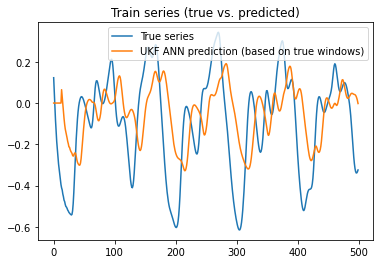

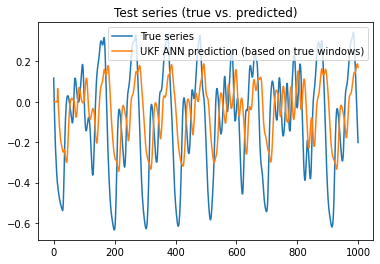

2020-07-17 17:27:55,483 [INFO] Training complete. time_to_train = 266.68 sec, 4.44 min
2020-07-17 17:27:55,485 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:55,486 [INFO] Evaluating and visualizing neural net predictions


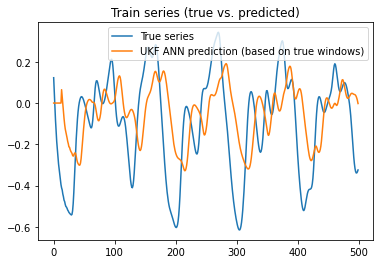

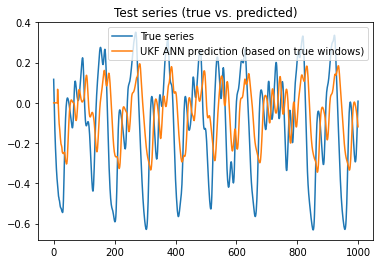

2020-07-17 17:27:56,829 [INFO] Training complete. time_to_train = 268.03 sec, 4.47 min
2020-07-17 17:27:56,829 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:56,831 [INFO] Evaluating and visualizing neural net predictions


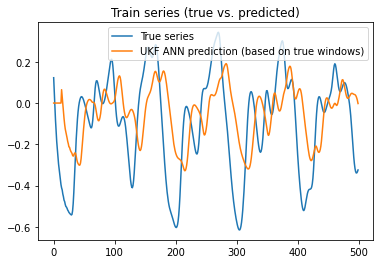

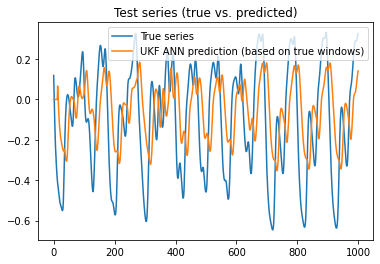

2020-07-17 17:27:58,168 [INFO] Training complete. time_to_train = 269.37 sec, 4.49 min
2020-07-17 17:27:58,169 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:58,169 [INFO] Evaluating and visualizing neural net predictions


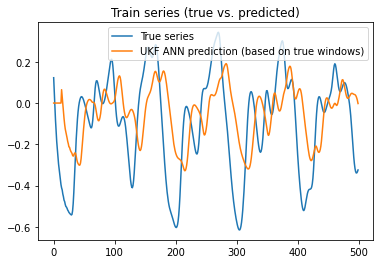

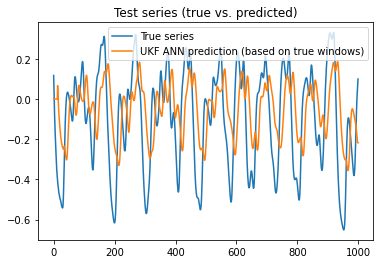

2020-07-17 17:27:59,502 [INFO] Training complete. time_to_train = 270.70 sec, 4.51 min
2020-07-17 17:27:59,504 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:27:59,505 [INFO] Evaluating and visualizing neural net predictions


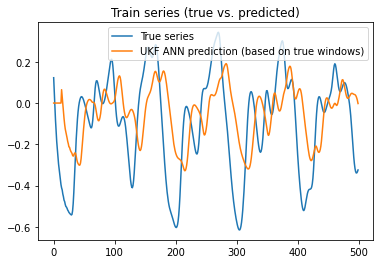

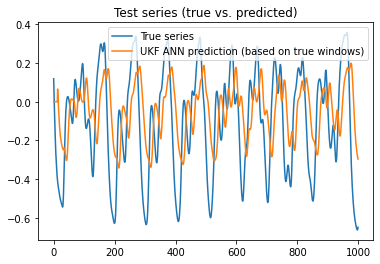

2020-07-17 17:28:01,384 [INFO] Training complete. time_to_train = 272.58 sec, 4.54 min
2020-07-17 17:28:01,386 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:28:01,387 [INFO] Evaluating and visualizing neural net predictions


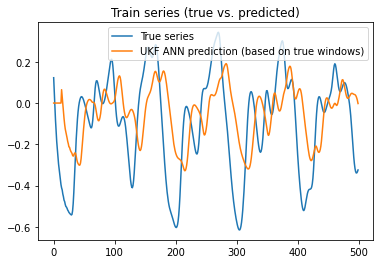

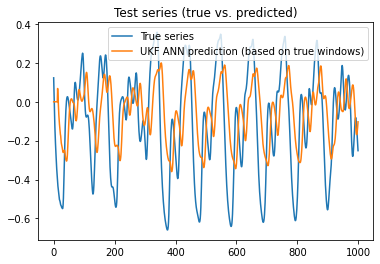

2020-07-17 17:28:02,715 [INFO] Training complete. time_to_train = 273.91 sec, 4.57 min
2020-07-17 17:28:02,716 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:28:02,718 [INFO] Evaluating and visualizing neural net predictions


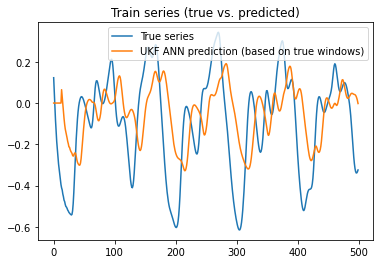

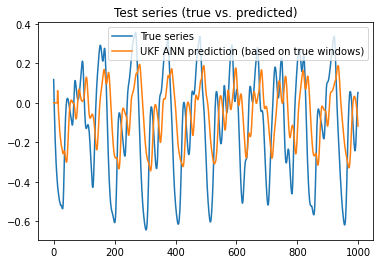

2020-07-17 17:28:04,093 [INFO] Training complete. time_to_train = 275.29 sec, 4.59 min
2020-07-17 17:28:04,096 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:28:04,097 [INFO] Evaluating and visualizing neural net predictions


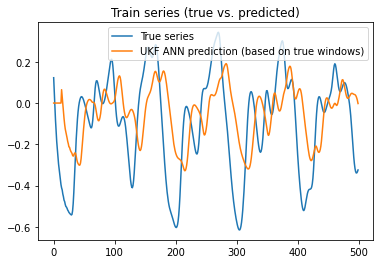

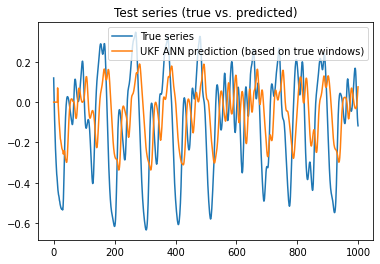

2020-07-17 17:28:05,475 [INFO] Training complete. time_to_train = 276.67 sec, 4.61 min
2020-07-17 17:28:05,475 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:28:05,476 [INFO] Evaluating and visualizing neural net predictions


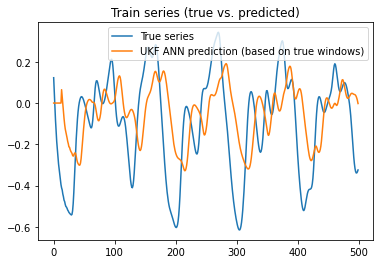

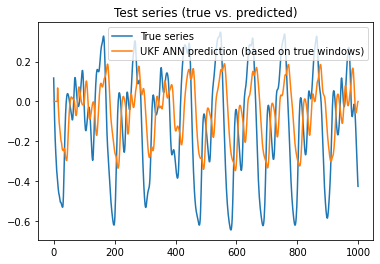

2020-07-17 17:28:06,838 [INFO] Training complete. time_to_train = 278.04 sec, 4.63 min
2020-07-17 17:28:06,842 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:28:06,845 [INFO] Evaluating and visualizing neural net predictions


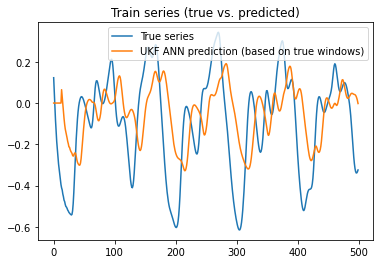

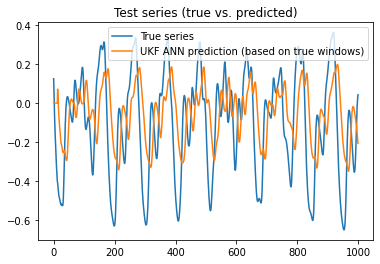

2020-07-17 17:28:08,207 [INFO] Training complete. time_to_train = 279.41 sec, 4.66 min
2020-07-17 17:28:08,207 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:28:08,211 [INFO] Evaluating and visualizing neural net predictions


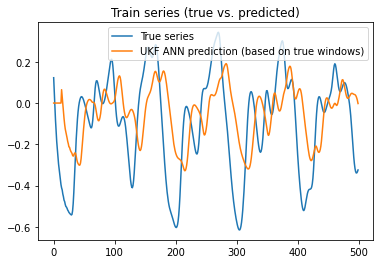

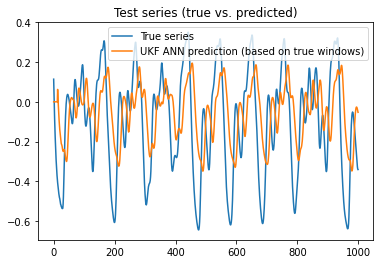

2020-07-17 17:28:09,563 [INFO] Training complete. time_to_train = 280.76 sec, 4.68 min
2020-07-17 17:28:09,563 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 17:28:09,565 [INFO] Evaluating and visualizing neural net predictions


In [ ]:
t0 = time.time()
epoch = 0
for i in range(num_iter):
  idx = i % len(z_true_series)
  if idx == 0:
    if not train_ukf_ann:
      break
                
    preds = ukf_ann.predict(params.X_data)
    mse = mean_squared_error(z_true_series, preds)
    ukf_train_mse[epoch] = mse

    ukf_w[:, epoch] = ukf_filter.x[:]
    epoch += 1
 
  curr_idx = idx 

  ukf_filter.predict()
  z = z_true_series[idx]
  ukf_filter.update(z)

  set_weights(params.hxw_model, ukf_filter.x)
  set_weights(ukf_ann, ukf_filter.x)


  time_to_train = time.time() - t0
  logging.info('Training complete. time_to_train = {:.2f} sec, {:.2f} min'.format(time_to_train, time_to_train / 60))

  logging.info('Visualize evolution of true y vs. hxw(x,w)')

  x_var = range(epochs)

  logging.info('Evaluating and visualizing neural net predictions')
  evaluate_neural_nets(None, ukf_ann, window, use_train_series=True, train_series=X_series)
  evaluate_neural_nets(None, ukf_ann, window)

  plt.show()

2020-07-17 18:38:15,671 [INFO] Experiment parameters below
2020-07-17 18:38:15,679 [INFO] 
{'Q_var': 0.001,
 'R_var': 0.001,
 'X_data': array([[ 0.1219316 ,  0.0500492 , -0.01996281, ..., -0.30659832,
        -0.33910194, -0.36240288],
       [ 0.0500492 , -0.01996281, -0.07257104, ..., -0.33910194,
        -0.36240288, -0.38527645],
       [-0.01996281, -0.07257104, -0.13167123, ..., -0.36240288,
        -0.38527645, -0.40947371],
       ...,
       [-0.13289779, -0.15202188, -0.17153389, ..., -0.21122466,
        -0.1812077 , -0.14015422],
       [-0.15202188, -0.17153389, -0.19069143, ..., -0.1812077 ,
        -0.14015422, -0.09140127],
       [-0.17153389, -0.19069143, -0.2084132 , ..., -0.14015422,
        -0.09140127, -0.04102966]]),
 'alpha': 1,
 'beta': 2,
 'curr_idx': 486,
 'epochs': 12,
 'hxw_model': <keras.engine.sequential.Sequential object at 0x7f99601019e8>,
 'kappa': 1,
 'mg_tau': 30,
 'test_series_length': 1000,
 'train_series_length': 500,
 'train_ukf_ann': True,
 'ukf

Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_15 (Dense)             (None, 1)                 13        
Total params: 13
Trainable params: 13
Non-trainable params: 0
_________________________________________________________________
Model: "sequential_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_16 (Dense)             (None, 1)                 13        
Total params: 13
Trainable params: 13
Non-trainable params: 0
_________________________________________________________________
Model: "sequential_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_17 (Dense)             (None, 1)                 13        
Total params: 13
Trainable params: 13
Non-trainable params: 0
___________________

2020-07-17 18:43:08,984 [INFO] Training complete. time_to_train = 293.16 sec, 4.89 min
2020-07-17 18:43:08,986 [INFO] Training neural net with SGD


Epoch 1/12
Epoch 2/12
Epoch 3/12
Epoch 4/12
Epoch 5/12
Epoch 6/12
Epoch 7/12
Epoch 8/12
Epoch 9/12
Epoch 10/12
Epoch 11/12
Epoch 12/12


2020-07-17 18:43:16,540 [INFO] Training SGD complete
2020-07-17 18:43:16,541 [INFO] Visualize evolution of UKF ANN weights
2020-07-17 18:43:16,610 [INFO] Visualize evolution of SGD ANN weights
2020-07-17 18:43:16,677 [INFO] Visualize evolution of true y vs. hxw(x,w)
2020-07-17 18:43:16,694 [INFO] Evaluating and visualizing neural net predictions


All figures saved to output


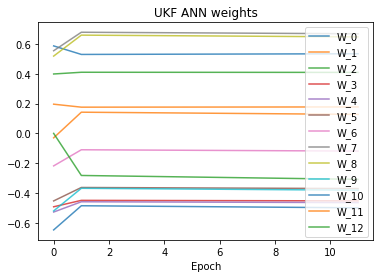

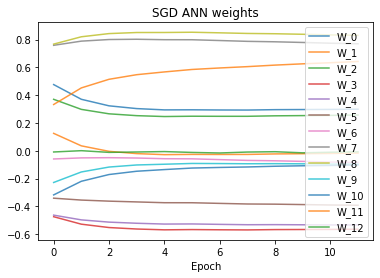

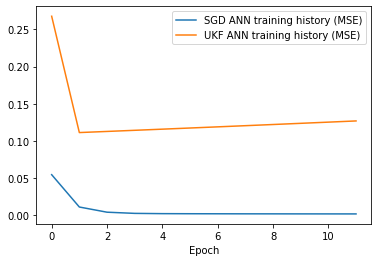

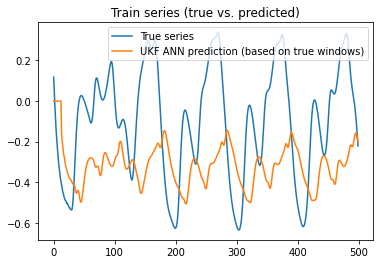

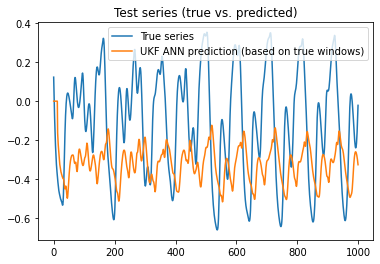

In [31]:
import utility
def main():
    utility.setup_logging('output')
    logging.info('Experiment parameters below')
    logging.info('\n{}'.format(pformat(params.__dict__)))

    # test_weights_functions()
    # assert False

    # -------------------------------------------
    # Setting parameters

    # Known paramaters are hx function (neural net), Q, R, w_init
    # No. of state variables = no. of weights in neural net
    # No. of measurement variables = D = 1 (y)

    window = params.window_size

    dt = 0.01
    n_samples = params.train_series_length

    # -------------------------------------------
    # Generating data
    X_series = utility.mackey_glass(sample_len=n_samples, tau=params.mg_tau, n_samples=window)
    X_series = np.array(X_series[0]).reshape((n_samples))

    params.X_data, params.y_data = prepare_dataset(X_series, window, stride=1)

    # Create ANN, get its initial weights
    params.hxw_model = create_neural_net(window)
    w_init = get_weights_vector(params.hxw_model)
    num_weights = w_init.shape[0]

    P_init = 0.1 * np.eye(num_weights)  # Initial values of covariance matrix of state variables (MxM)
    Q = params.Q_var * np.eye(num_weights)  # Process noise covariance matrix (MxM)
    R = np.array([[params.R_var]])  # Measurement noise covariance matrix (DxD)

    sgd_ann = create_neural_net(window)
    sgd_ann.set_weights(params.hxw_model.get_weights())  # Same starting point as the UKF_ANN

    ukf_ann = create_neural_net(window)
    ukf_ann.set_weights(params.hxw_model.get_weights())  # Same starting point as the UKF_ANN

    z_true_series = params.y_data
    num_iter = params.epochs * len(z_true_series)

    # 2 Kalman filter implementations to compare (from filterpy and my custom impl)
    ukf_filter = create_ukf(Q, R, dt, w_init, P_init)
    #my_ukf = create_my_ukf(Q, R, dt, w_init, P_init)

    # Pre-allocate output variables
    ukf_w = np.zeros((num_weights, params.epochs))
    #my_ukf_w = np.zeros((num_weights, params.epochs))
    ukf_train_mse = np.zeros(params.epochs)
    #my_ukf_train_mse = np.zeros(params.epochs)
    #sgd_train_mse = np.zeros(params.epochs)

    # -------------------------------------------
    # Training loop with UKF

    logging.info("Training neural net with UKF")
    t0 = time.time()
    epoch = 0

    for i in range(num_iter):
        idx = i % len(z_true_series)
        # logging.info(idx)
        if idx == 0:
            if not params.train_ukf_ann:
                break

            preds = ukf_ann.predict(params.X_data)
            mse = mean_squared_error(z_true_series, preds)
            ukf_train_mse[epoch] = mse
            #my_ukf_train_mse[epoch] = mse

            ukf_w[:, epoch] = ukf_filter.x[:]
            #my_ukf_w[:, epoch] = my_ukf.x[:]

            epoch += 1
            #logging.info('Epoch: {} / {}'.format(epoch, params.epochs))

        params.curr_idx = idx  # For use in hw() to fetch correct x_k sample

        # Time update (state prediction according to F, Q
        ukf_filter.predict()
        #my_ukf.predict()

        # Measurement update (innovation) according to observed z, H, R
        z = z_true_series[idx]
        ukf_filter.update(z)
        #my_ukf.update(z)

        set_weights(params.hxw_model, ukf_filter.x)
        set_weights(ukf_ann, ukf_filter.x)

        # filter.x has shape Mx1
        # ukf_w[:, i] = ukf_filter.x[:]
        # my_ukf_w[:, i] = my_ukf.x[:]

    time_to_train = time.time() - t0
    logging.info('Training complete. time_to_train = {:.2f} sec, {:.2f} min'.format(time_to_train, time_to_train / 60))

  
    # -------------------------------------------
    # Results analysis
    logging.info("Training neural net with SGD")
    info_tracker = EpochInfoTracker()
    callbacks = [info_tracker]
    history = sgd_ann.fit(params.X_data, params.y_data, batch_size=1, epochs=params.epochs, verbose=3,
                          callbacks=callbacks)
    logging.info('Training SGD complete')
    # Visualize evolution of ANN weights
    sgd_ann_w = np.array(info_tracker.weights_history).T

    logging.info('Visualize evolution of UKF ANN weights')

    x_var = range(params.epochs)
    utility.plot(x_var, ukf_w[0, :], xlabel='Epoch', title='UKF ANN weights', label='W_0', alpha=0.8)
    for j in range(1, ukf_w.shape[0]):
        utility.plot(x_var, ukf_w[j, :], new_figure=False, label='W_' + str(j), alpha=0.8)

    logging.info('Visualize evolution of SGD ANN weights')

    x_var = range(params.epochs)
    utility.plot(x_var, sgd_ann_w[0, :], xlabel='Epoch', title='SGD ANN weights', label='W_0', alpha=0.8)
    for j in range(1, sgd_ann_w.shape[0]):
        utility.plot(x_var, sgd_ann_w[j, :], new_figure=False, label='W_' + str(j), alpha=0.8)

    # Visualize evolution of true y vs. hxw(x,w)
    logging.info('Visualize evolution of true y vs. hxw(x,w)')

    # Visualize error curve (SGD vs UKF)
    x_var = range(params.epochs)
    hist = history.history['loss']
    utility.plot(x_var, hist, xlabel='Epoch', label='SGD ANN training history (MSE)')
    utility.plot(x_var, ukf_train_mse, new_figure=False, label='UKF ANN training history (MSE)')

    # True test series vs. ANN pred vs, UKF pred
    logging.info('Evaluating and visualizing neural net predictions')
    evaluate_neural_nets(sgd_ann, ukf_ann, window, use_train_series=True, train_series=X_series)
    evaluate_neural_nets(sgd_ann, ukf_ann, window)

    utility.save_all_figures('output')
    plt.show()


if __name__ == "__main__":
    os.environ['CUDA_VISIBLE_DEVICES'] = '-1' # This line disables GPU
    main()